In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

# Cargar imágenes desde los archivos
image_paths = [
    "./imagenes_proyecto/1717.png",
    "./imagenes_proyecto/2242.png",
    "./imagenes_proyecto/3246.png",
    "./imagenes_proyecto/3302.png"
]

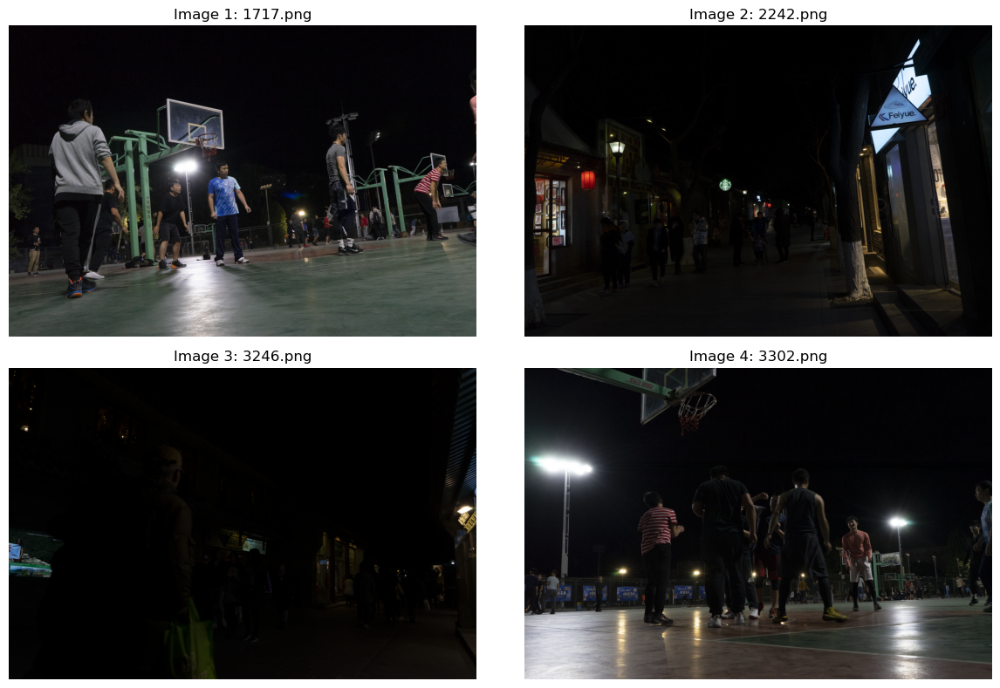

In [3]:
# Cargar las imágenes en color con OpenCV y convertir de BGR a RGB
images_bgr = [cv2.imread(img_path) for img_path in image_paths]
images_rgb = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images_bgr]
image_titles = ["Image 1: 1717.png", "Image 2: 2242.png", "Image 3: 3246.png", "Image 4: 3302.png"]

# Mostrar las imágenes una a una en RGB
plt.figure(figsize=(12, 8))

for i, (img, title) in enumerate(zip(images_rgb, image_titles)):
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)  # Mostrar imagen en RGB
    plt.title(title)
    plt.axis('off')

plt.tight_layout()
plt.show()


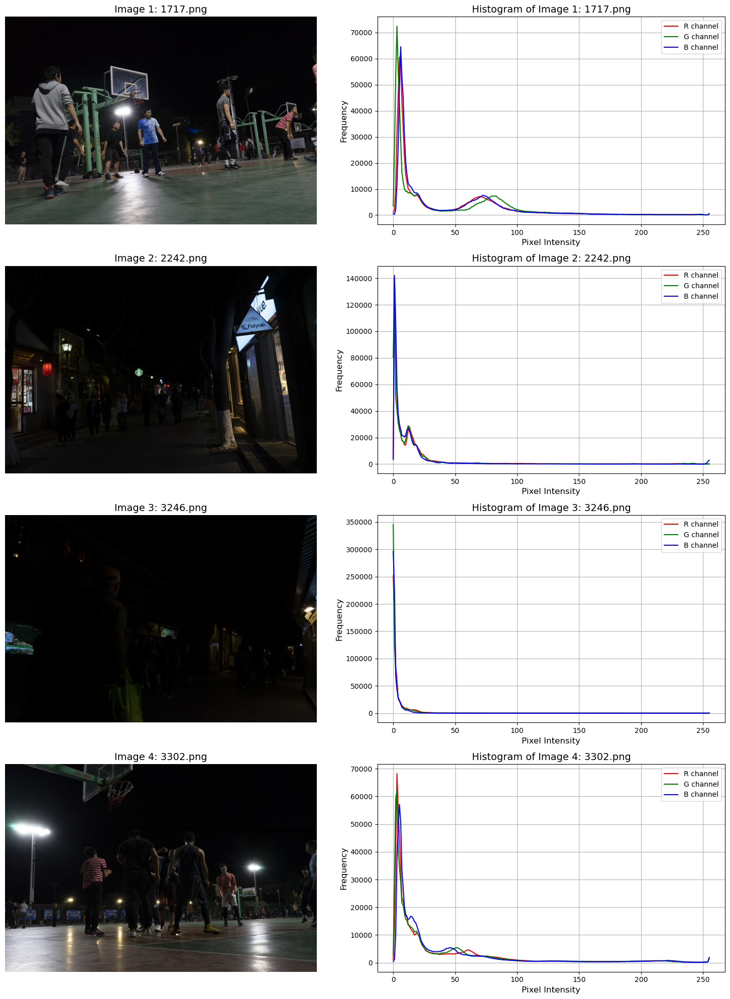

In [4]:
# Mostrar imágenes y sus histogramas combinados en RGB
plt.figure(figsize=(15, 20))  # Tamaño de la figura general

for i, (img, title) in enumerate(zip(images_rgb, image_titles)):
    # Mostrar la imagen
    plt.subplot(len(images_rgb), 2, 2*i + 1)
    plt.imshow(img)
    plt.title(title, fontsize=14)
    plt.axis('off')

    # Mostrar el histograma combinado (R, G, B)
    plt.subplot(len(images_rgb), 2, 2*i + 2)
    for j, color in enumerate(('r', 'g', 'b')):
        hist = cv2.calcHist([img], [j], None, [256], [0, 256])
        plt.plot(hist, color=color, label=f"{color.upper()} channel")
    plt.title(f"Histogram of {title}", fontsize=14)
    plt.xlabel("Pixel Intensity", fontsize=12)
    plt.ylabel("Frequency", fontsize=12)
    plt.legend()
    plt.grid()

plt.tight_layout()
plt.show()


<h1>APLICAREMOS LAS TRANSFORMACIONES CORRESPONDIENTES A CADA UNA DE LAS IMÁGENES</h1>

<H2>Comenzaremos con la imágen 3246.png, que es la que muestra una mayor oscuridad.</H2>

<h3>Primero, usaremos la corrección gamma con varios valores para observar sus resultados y ver cuál es el óptimo.</h3>

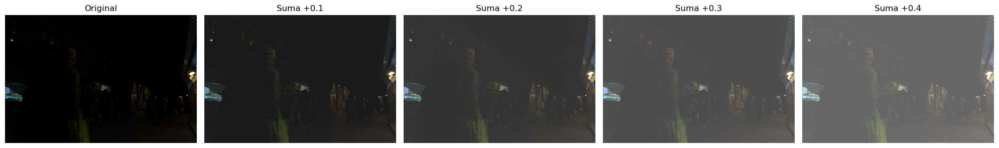

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, img_as_float, img_as_ubyte
from skimage.util import img_as_ubyte

# Cargar la imagen original
image_path = './imagenes_proyecto/3246.png'  # Reemplaza con la ruta de tu imagen
original_image = img_as_float(io.imread(image_path))

# Valores de suma a aplicar
sum_values = [0.1, 0.2, 0.3, 0.4]  # Valores en formato de suma normalizada (para 0-1)

# Crear una lista para almacenar las imágenes transformadas
transformed_images = [original_image]

# Aplicar la suma con diferentes valores
for value in sum_values:
    added_image = np.clip(original_image + value, 0, 1)  # Clipping para evitar saturación
    transformed_images.append(added_image)

# Crear el collage con la imagen original y las transformadas
cols = len(transformed_images)
fig, axes = plt.subplots(1, cols, figsize=(20, 5))

# Mostrar las imágenes en el collage
axes[0].imshow(original_image)
axes[0].set_title("Original")
axes[0].axis('off')

for i, value in enumerate(sum_values):
    axes[i + 1].imshow(transformed_images[i + 1])
    axes[i + 1].set_title(f"Suma +{value}")
    axes[i + 1].axis('off')

# Ajustar el diseño y guardar el collage
plt.tight_layout()
plt.savefig("./suma/suma_collage_scikit.png")
plt.show()


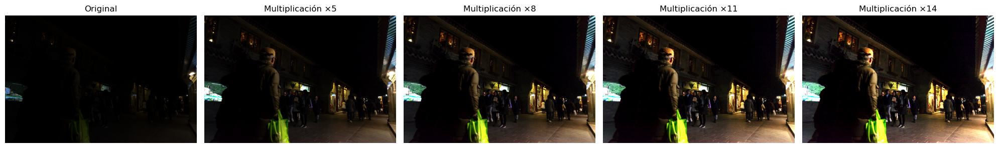

In [86]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, img_as_float, img_as_ubyte

# Cargar la imagen original
image_path = './imagenes_proyecto/3246.png'  # Reemplaza con la ruta de tu imagen
original_image = img_as_float(io.imread(image_path))

# Valores de multiplicación a aplicar
multiplication_values = [5, 8, 11, 14]

# Crear una lista para almacenar las imágenes transformadas
transformed_images = [original_image]

# Aplicar la multiplicación con diferentes valores
for value in multiplication_values:
    multiplied_image = np.clip(original_image * value, 0, 1)  # Clipping para evitar saturación
    transformed_images.append(multiplied_image)

# Crear el collage con la imagen original y las transformadas
cols = len(transformed_images)
fig, axes = plt.subplots(1, cols, figsize=(20, 5))

# Mostrar las imágenes en el collage
axes[0].imshow(original_image)
axes[0].set_title("Original")
axes[0].axis('off')

for i, value in enumerate(multiplication_values):
    axes[i + 1].imshow(transformed_images[i + 1])
    axes[i + 1].set_title(f"Multiplicación ×{value}")
    axes[i + 1].axis('off')

# Ajustar el diseño y guardar el collage
plt.tight_layout()
plt.savefig("./multiplicacion/multiplication_collage_scikit_mejores.png")
plt.show()


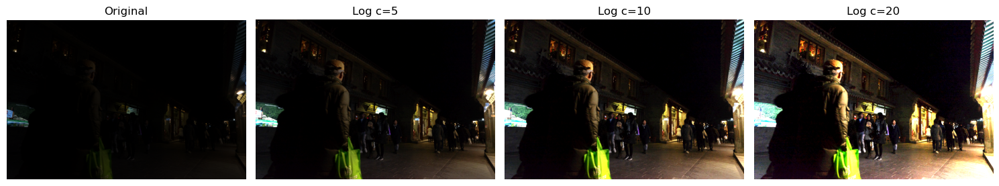

In [94]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, img_as_float

# Cargar la imagen original
image_path = './imagenes_proyecto/3246.png'  # Reemplaza con la ruta a tu imagen
original_image = img_as_float(io.imread(image_path))

# Valores del parámetro c a probar
c_values = [5, 10, 20]

# Crear una lista para almacenar las imágenes transformadas
transformed_images = []

# Aplicar la transformación logarítmica con diferentes valores de c
for c in c_values:
    log_image = np.clip(c * np.log1p(original_image), 0, 1)  # log1p evita log(0)
    transformed_images.append((c, log_image))

# Crear el collage para mostrar las imágenes transformadas
cols = len(transformed_images) + 1  # Una columna adicional para la imagen original
fig, axes = plt.subplots(1, cols, figsize=(15, 5))

# Mostrar la imagen original
axes[0].imshow(original_image)
axes[0].set_title("Original")
axes[0].axis('off')

# Mostrar las imágenes transformadas
for i, (c, img) in enumerate(transformed_images):
    axes[i + 1].imshow(img)
    axes[i + 1].set_title(f"Log c={c}")
    axes[i + 1].axis('off')

# Ajustar diseño y guardar el collage
plt.tight_layout()
plt.savefig("./transformacion_log/log_transformation_collage_medium.png")
plt.show()


In [5]:
def apply_gamma_correction(img, gamma=1.0):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in range(256)]).astype("uint8")
    return cv2.LUT(img, table)

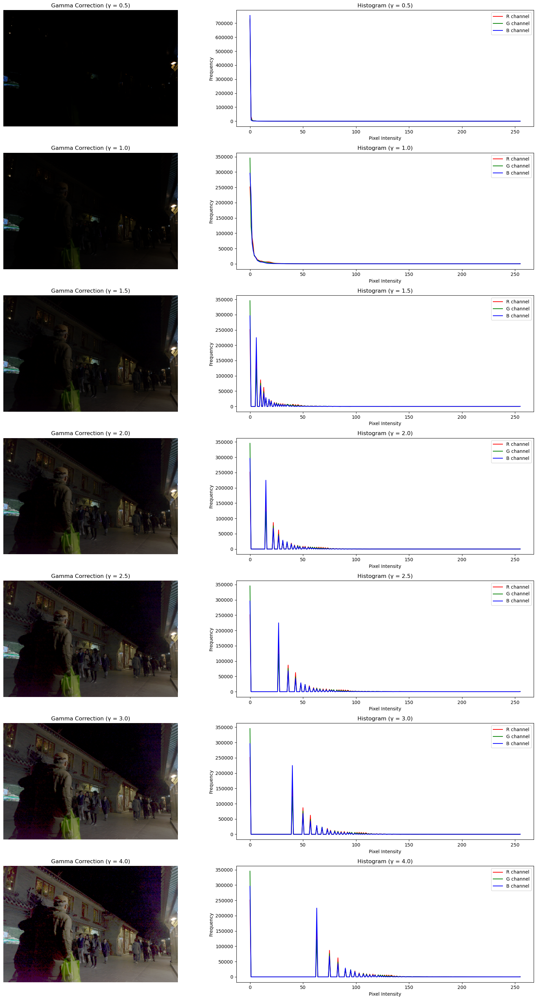

In [6]:
# Seleccionar la imagen 3246.png en RGB
image_3246_rgb = images_rgb[2]

# Definir valores de gamma a probar
gamma_values = [0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 4.0]

# Aplicar transformación gamma
gamma_corrected_images = [apply_gamma_correction(image_3246_rgb, gamma) for gamma in gamma_values]

# Mostrar imágenes corregidas con sus histogramas combinados
plt.figure(figsize=(18, 30))

for i, (gamma, img_gamma) in enumerate(zip(gamma_values, gamma_corrected_images)):
    # Mostrar imagen corregida
    plt.subplot(len(gamma_values), 2, 2*i + 1)
    plt.imshow(img_gamma)
    plt.title(f"Gamma Correction (γ = {gamma})", fontsize=12)
    plt.axis('off')

    # Mostrar histograma combinado
    plt.subplot(len(gamma_values), 2, 2*i + 2)
    for j, color in enumerate(('r', 'g', 'b')):
        hist = cv2.calcHist([img_gamma], [j], None, [256], [0, 256])
        plt.plot(hist, color=color, label=f"{color.upper()} channel")
    plt.title(f"Histogram (γ = {gamma})", fontsize=12)
    plt.xlabel("Pixel Intensity", fontsize=10)
    plt.ylabel("Frequency", fontsize=10)
    plt.legend()

plt.tight_layout()
plt.show()


In [7]:
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Calcular métricas PSNR y SSIM entre imágenes originales y gamma-corrected
original_image = images_rgb[2]  # Imagen original en RGB
metrics_results = []

for gamma, img_gamma in zip(gamma_values, gamma_corrected_images):
    # Calcular PSNR
    psnr_value = psnr(original_image, img_gamma, data_range=255)
    # Calcular SSIM con win_size ajustado y canal RGB
    ssim_value = ssim(original_image, img_gamma, win_size=3, channel_axis=2, data_range=255)
    metrics_results.append((gamma, psnr_value, ssim_value))

# Mostrar los resultados
print(f"{'Gamma':<10} {'PSNR (dB)':<15} {'SSIM':<15}")
for gamma, psnr_value, ssim_value in metrics_results:
    print(f"{gamma:<10} {psnr_value:<15.2f} {ssim_value:<15.4f}")


/opt/anaconda3/envs/actividad1_VA/lib/python3.12/site-packages/skimage/metrics/simple_metrics.py:168: RuntimeWarning: divide by zero encountered in scalar divide
  return 10 * np.log10((data_range**2) / err)


Gamma      PSNR (dB)       SSIM           
0.5        30.25           0.6995         
1.0        inf             1.0000         
1.5        27.71           0.6591         
2.0        21.18           0.4365         
2.5        17.47           0.3518         
3.0        15.02           0.3196         
4.0        11.97           0.2965         


In [8]:
# Guardar las imágenes con gamma aplicado a la imagen original 3246.png en el directorio de trabajo
gamma_values = [0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 4.0]  # Valores de gamma utilizados
image_3246_rgb = images_rgb[2]  # Imagen original 3246.png en RGB

# Crear y guardar las imágenes con gamma aplicado
gamma_images_paths = {}
for gamma in gamma_values:
    # Aplicar la transformación gamma
    img_gamma = apply_gamma_correction(image_3246_rgb, gamma)
    # Generar la ruta y el nombre del archivo
    filename = f"./imagenes_transformadas/3246/gamma/3246_gamma_{gamma}.png"
    # Guardar la imagen
    cv2.imwrite(filename, cv2.cvtColor(img_gamma, cv2.COLOR_RGB2BGR))
    gamma_images_paths[f"Gamma {gamma}"] = filename

# Mostrar las rutas donde se han guardado las imágenes
gamma_images_paths

{'Gamma 0.5': './imagenes_transformadas/3246/gamma/3246_gamma_0.5.png',
 'Gamma 1.0': './imagenes_transformadas/3246/gamma/3246_gamma_1.0.png',
 'Gamma 1.5': './imagenes_transformadas/3246/gamma/3246_gamma_1.5.png',
 'Gamma 2.0': './imagenes_transformadas/3246/gamma/3246_gamma_2.0.png',
 'Gamma 2.5': './imagenes_transformadas/3246/gamma/3246_gamma_2.5.png',
 'Gamma 3.0': './imagenes_transformadas/3246/gamma/3246_gamma_3.0.png',
 'Gamma 4.0': './imagenes_transformadas/3246/gamma/3246_gamma_4.0.png'}

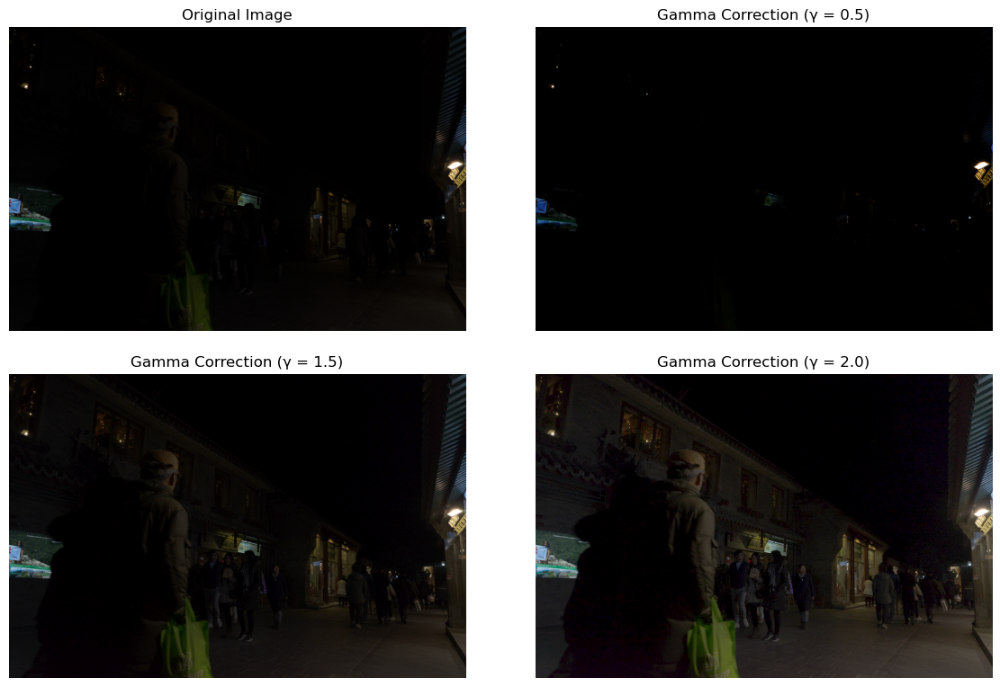

In [9]:
# Seleccionar las imágenes para comparación visual
gamma_best_1 = apply_gamma_correction(images_rgb[2], 0.5) 
gamma_best_2 = apply_gamma_correction(images_rgb[2], 1.5)
gamma_best_3 = apply_gamma_correction(images_rgb[2], 2.0)

# Mostrar las imágenes para comparación en dos filas y dos columnas
plt.figure(figsize=(12, 8))

# Imagen original
plt.subplot(2, 2, 1)
plt.imshow(images_rgb[2])
plt.title("Original Image")
plt.axis('off')

# Gamma 0.5
plt.subplot(2, 2, 2)
plt.imshow(gamma_best_1)
plt.title("Gamma Correction (γ = 0.5)")
plt.axis('off')

# Gamma 1.5
plt.subplot(2, 2, 3)
plt.imshow(gamma_best_2)
plt.title("Gamma Correction (γ = 1.5)")
plt.axis('off')

# Gamma 2.0
plt.subplot(2, 2, 4)
plt.imshow(gamma_best_3)
plt.title("Gamma Correction (γ = 2.0)")
plt.axis('off')

plt.tight_layout(pad=2.0)
plt.show()


<h3>Ahora, procedemos con la ecualización de histograma de esta imagen. </h3>

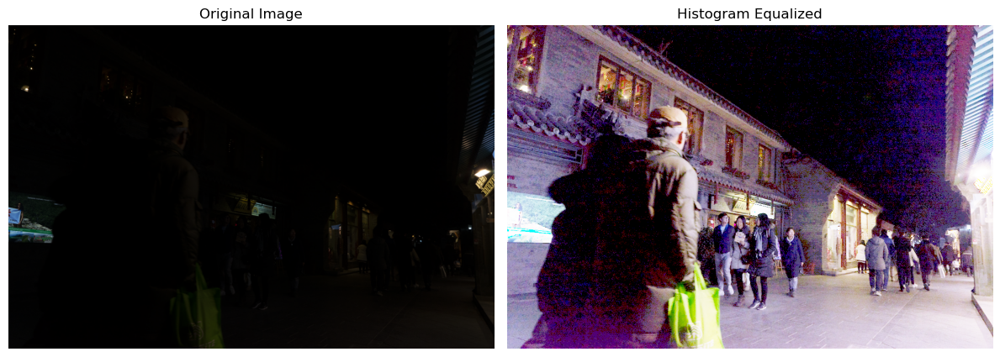

In [10]:
# Función para aplicar ecualización del histograma en imágenes RGB
def equalize_histogram_rgb(img_rgb):
    # Separar canales R, G y B
    r, g, b = cv2.split(img_rgb)
    # Aplicar ecualización del histograma en cada canal
    r_eq = cv2.equalizeHist(r)
    g_eq = cv2.equalizeHist(g)
    b_eq = cv2.equalizeHist(b)
    # Combinar canales nuevamente
    return cv2.merge((r_eq, g_eq, b_eq))

# Aplicar ecualización del histograma a la imagen 3246.png
hist_equalized_image = equalize_histogram_rgb(images_rgb[2])

# Mostrar la imagen original y la imagen con histograma ecualizado
plt.figure(figsize=(12, 6))

# Imagen original
plt.subplot(1, 2, 1)
plt.imshow(images_rgb[2])
plt.title("Original Image")
plt.axis('off')

# Imagen con histograma ecualizado
plt.subplot(1, 2, 2)
plt.imshow(hist_equalized_image)
plt.title("Histogram Equalized")
plt.axis('off')

plt.tight_layout()
plt.show()


In [11]:
# Ruta de la carpeta destino
output_dir_eq = "./imagenes_transformadas/3246/ecualizacion_histograma"
if not os.path.exists(output_dir_eq):
    os.makedirs(output_dir_eq)

# Guardar la imagen ecualizada
output_path_eq = os.path.join(output_dir_eq, "histogram_equalized_3246.png")
cv2.imwrite(output_path_eq, cv2.cvtColor(hist_equalized_image, cv2.COLOR_RGB2BGR))
print(f"Imagen guardada en: {output_path_eq}")


Imagen guardada en: ./imagenes_transformadas/3246/ecualizacion_histograma/histogram_equalized_3246.png


<h3>Aplicamos la técnica de CLAHE, ya que los resultados obtenidos con la ecualización de histograma no han sido muy prometedores.</h3>

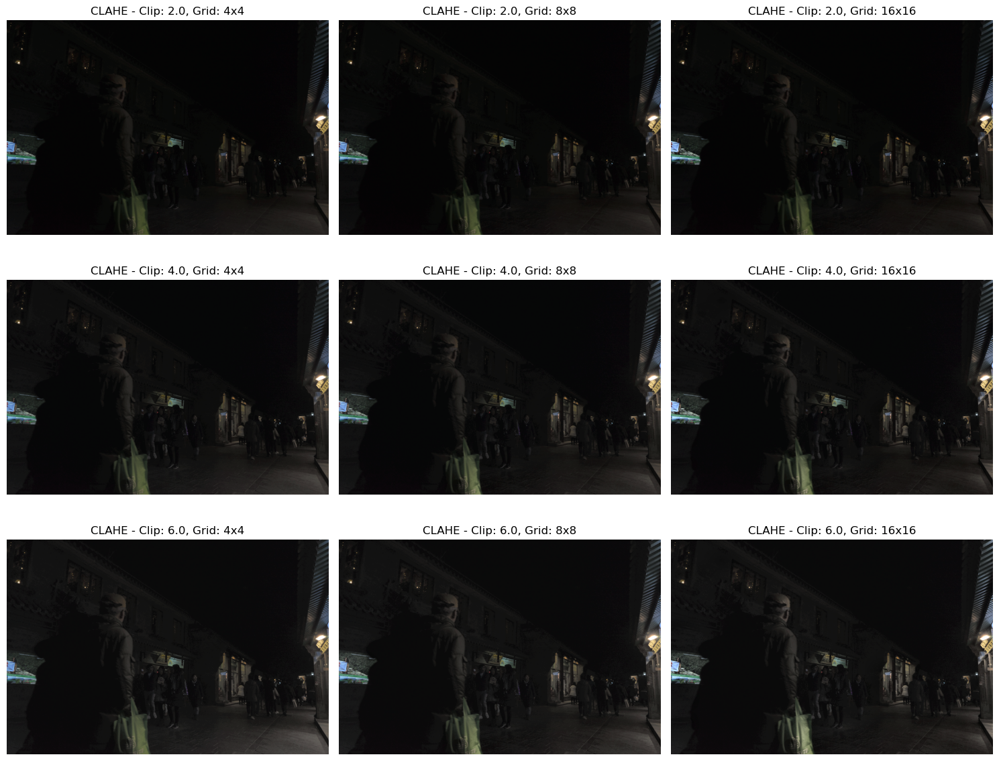

In [12]:
# Función para aplicar CLAHE en imágenes RGB con hiperparámetros ajustables
def apply_clahe_rgb(img_rgb, clip_limit=2.0, tile_grid_size=(8, 8)):
    # Convertir a espacio de color LAB (para preservar los colores)
    lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)
    # Aplicar CLAHE en el canal L (luminancia)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l_clahe = clahe.apply(l)
    # Combinar canales de nuevo
    lab_clahe = cv2.merge((l_clahe, a, b))
    return cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2RGB)

# Probar diferentes valores de clipLimit y tileGridSize
clip_limits = [2.0, 4.0, 6.0]  # Valores de límite de contraste
tile_grid_sizes = [(4, 4), (8, 8), (16, 16)]  # Tamaño de la grilla local

# Aplicar CLAHE a la imagen 3246.png con diferentes hiperparámetros
clahe_results = []
for clip in clip_limits:
    for grid in tile_grid_sizes:
        clahe_img = apply_clahe_rgb(images_rgb[2], clip_limit=clip, tile_grid_size=grid)
        clahe_results.append((clip, grid, clahe_img))

# Mostrar los resultados
plt.figure(figsize=(15, 12))

for i, (clip, grid, img_clahe) in enumerate(clahe_results):
    plt.subplot(len(clip_limits), len(tile_grid_sizes), i + 1)
    plt.imshow(img_clahe)
    plt.title(f"CLAHE - Clip: {clip}, Grid: {grid[0]}x{grid[1]}")
    plt.axis('off')

plt.tight_layout()
plt.show()


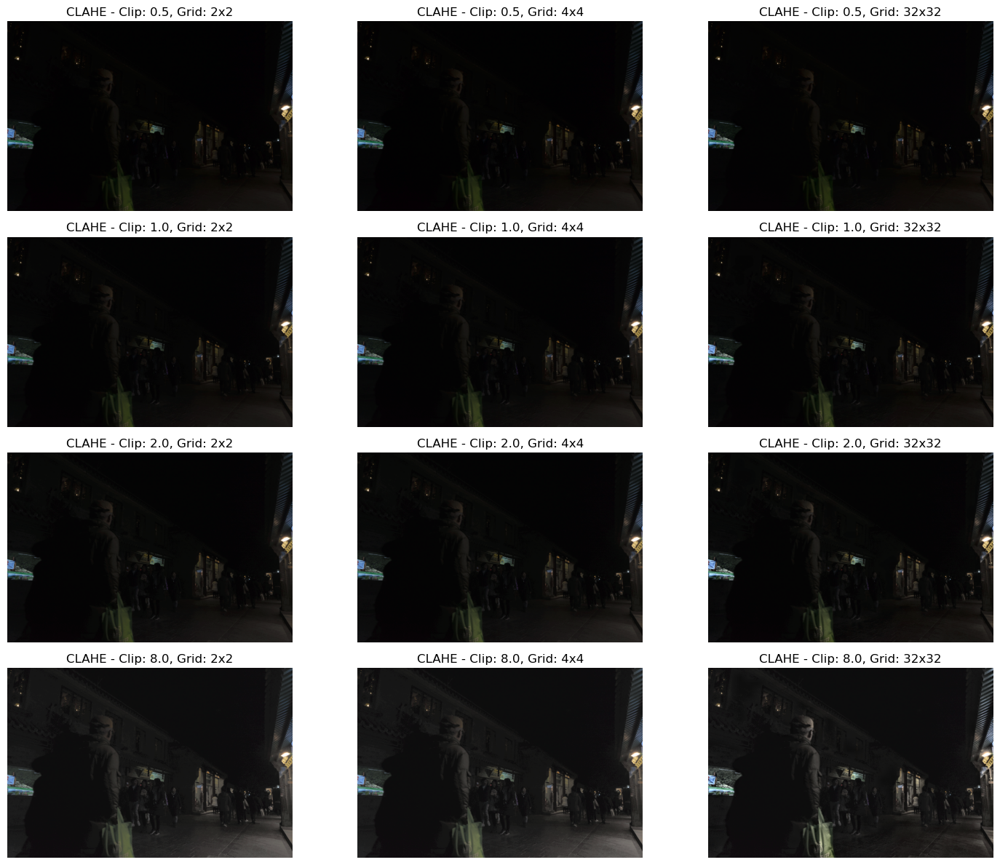

In [13]:
# Nuevos parámetros para CLAHE
clip_limits = [0.5, 1.0, 2.0, 8.0]  # Probar con valores más extremos de clipLimit
tile_grid_sizes = [(2, 2), (4, 4), (32, 32)]  # Grillas pequeñas y grandes

# Aplicar CLAHE a la imagen 3246.png con nuevos hiperparámetros
clahe_results_adjusted = []
for clip in clip_limits:
    for grid in tile_grid_sizes:
        clahe_img = apply_clahe_rgb(images_rgb[2], clip_limit=clip, tile_grid_size=grid)
        clahe_results_adjusted.append((clip, grid, clahe_img))

# Mostrar los resultados
plt.figure(figsize=(15, 12))

for i, (clip, grid, img_clahe) in enumerate(clahe_results_adjusted):
    plt.subplot(len(clip_limits), len(tile_grid_sizes), i + 1)
    plt.imshow(img_clahe)
    plt.title(f"CLAHE - Clip: {clip}, Grid: {grid[0]}x{grid[1]}")
    plt.axis('off')

plt.tight_layout()
plt.show()


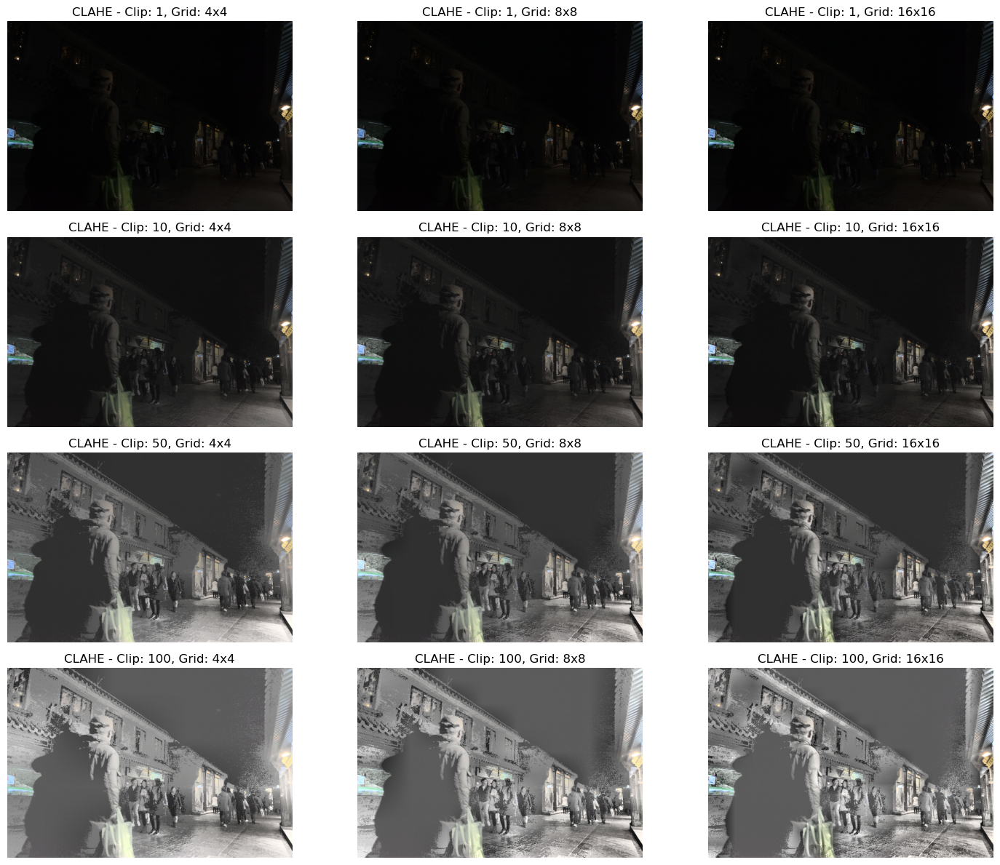

In [96]:
# Nuevos parámetros para CLAHE
clip_limits = [1, 10, 50, 100]  # Probar con valores más extremos de clipLimit
tile_grid_sizes = [(4, 4), (8, 8), (16, 16)]  # Grillas pequeñas y grandes

# Aplicar CLAHE a la imagen 3246.png con nuevos hiperparámetros
clahe_results_adjusted = []
for clip in clip_limits:
    for grid in tile_grid_sizes:
        clahe_img = apply_clahe_rgb(images_rgb[2], clip_limit=clip, tile_grid_size=grid)
        clahe_results_adjusted.append((clip, grid, clahe_img))

# Mostrar los resultados
plt.figure(figsize=(15, 12))

for i, (clip, grid, img_clahe) in enumerate(clahe_results_adjusted):
    plt.subplot(len(clip_limits), len(tile_grid_sizes), i + 1)
    plt.imshow(img_clahe)
    plt.title(f"CLAHE - Clip: {clip}, Grid: {grid[0]}x{grid[1]}")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [14]:
import os

# Ruta de la carpeta destino
output_dir = "./imagenes_transformadas/3246/clahe"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Guardar las imágenes con nombres descriptivos
index = 1
for clip, grid, img_clahe in clahe_results_adjusted:
    filename = f"clahe_clip_{clip}_grid_{grid[0]}x{grid[1]}.png"
    save_path = os.path.join(output_dir, filename)
    cv2.imwrite(save_path, cv2.cvtColor(img_clahe, cv2.COLOR_RGB2BGR))
    print(f"Guardado: {save_path}")


Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_0.5_grid_2x2.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_0.5_grid_4x4.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_0.5_grid_32x32.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_1.0_grid_2x2.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_1.0_grid_4x4.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_1.0_grid_32x32.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_2.0_grid_2x2.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_2.0_grid_4x4.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_2.0_grid_32x32.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_8.0_grid_2x2.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_8.0_grid_4x4.png
Guardado: ./imagenes_transformadas/3246/clahe/clahe_clip_8.0_grid_32x32.png


In [15]:
# Lista de parámetros para CLAHE
clahe_parameters = [
    (2.0, (2, 2)), (2.0, (4, 4)), (2.0, (32, 32)),
    (4.0, (2, 2)), (4.0, (4, 4)), (4.0, (32, 32)),
    (8.0, (2, 2)), (8.0, (4, 4)), (8.0, (32, 32))
]

# Calcular PSNR y SSIM con un win_size más pequeño para SSIM
results = []
for clip, grid in clahe_parameters:
    img_clahe = apply_clahe_rgb(images_rgb[2], clip_limit=clip, tile_grid_size=grid)
    # Calcular PSNR
    psnr_value = psnr(images_rgb[2], img_clahe, data_range=255)
    # Calcular SSIM con win_size=5
    ssim_value = ssim(images_rgb[2], img_clahe, channel_axis=2, win_size=5, data_range=255)
    # Guardar resultados
    results.append((clip, grid, psnr_value, ssim_value, img_clahe))

# Ordenar los resultados por SSIM y PSNR (priorizando SSIM)
results_sorted = sorted(results, key=lambda x: (x[3], x[2]), reverse=True)

# Mostrar las tres mejores imágenes numéricamente
print("Top 3 mejores imágenes con CLAHE:")
print(f"{'Clip':<6} {'Grid':<10} {'PSNR (dB)':<12} {'SSIM':<8}")
for clip, grid, psnr_value, ssim_value, _ in results_sorted[:3]:
    print(f"{clip:<6} {grid[0]}x{grid[1]:<8} {psnr_value:<12.2f} {ssim_value:<8.4f}")

# Guardar las tres mejores imágenes
output_dir = "./imagenes_transformadas/3246/clahe_best"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for i, (clip, grid, _, _, img_clahe) in enumerate(results_sorted[:3]):
    filename = f"clahe_best_{i+1}_clip_{clip}_grid_{grid[0]}x{grid[1]}.png"
    save_path = os.path.join(output_dir, filename)
    cv2.imwrite(save_path, cv2.cvtColor(img_clahe, cv2.COLOR_RGB2BGR))
    print(f"Guardado: {save_path}")


Top 3 mejores imágenes con CLAHE:
Clip   Grid       PSNR (dB)    SSIM    
2.0    32x32       28.53        0.4359  
2.0    2x2        29.25        0.4241  
2.0    4x4        28.81        0.4201  
Guardado: ./imagenes_transformadas/3246/clahe_best/clahe_best_1_clip_2.0_grid_32x32.png
Guardado: ./imagenes_transformadas/3246/clahe_best/clahe_best_2_clip_2.0_grid_2x2.png
Guardado: ./imagenes_transformadas/3246/clahe_best/clahe_best_3_clip_2.0_grid_4x4.png


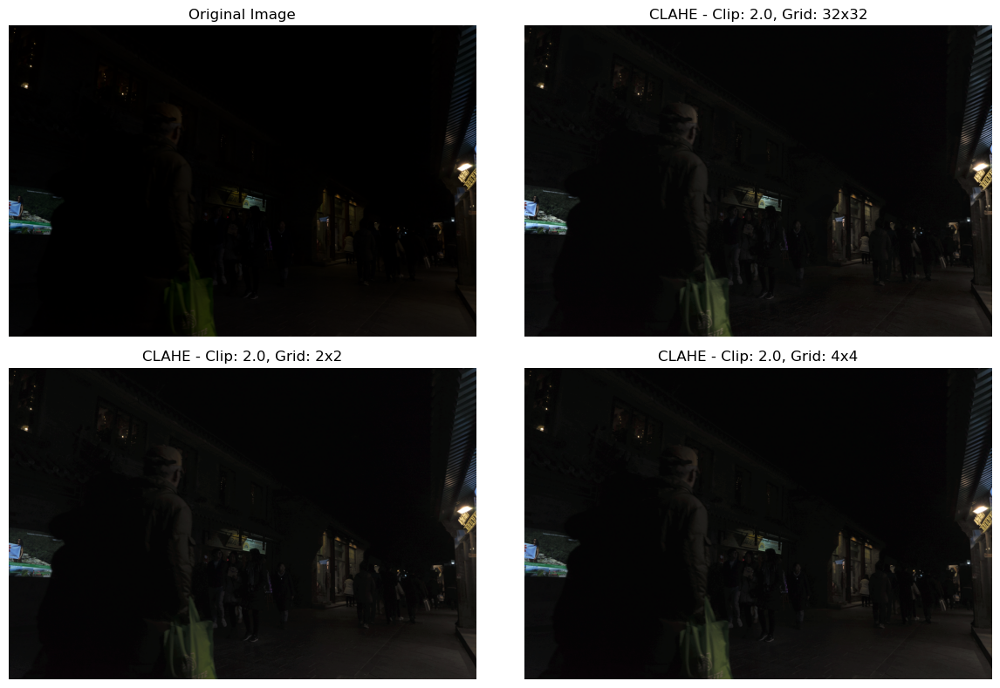

In [16]:
# Mostrar la imagen original y las tres mejores imágenes
plt.figure(figsize=(12, 8))

# Imagen original
plt.subplot(2, 2, 1)
plt.imshow(images_rgb[2])
plt.title("Original Image")
plt.axis('off')

# Mostrar las tres mejores imágenes
for i, (clip, grid, _, _, img_clahe) in enumerate(results_sorted[:3]):
    plt.subplot(2, 2, i + 2)
    plt.imshow(img_clahe)
    plt.title(f"CLAHE - Clip: {clip}, Grid: {grid[0]}x{grid[1]}")
    plt.axis('off')

plt.tight_layout()
plt.show()


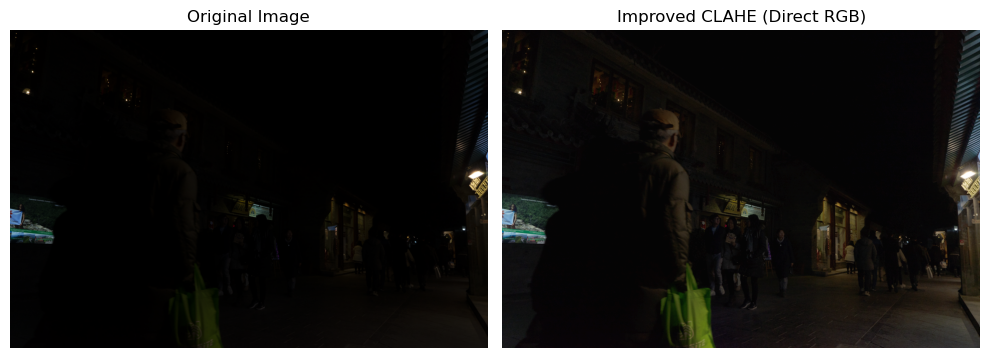

In [17]:
# Aplicar CLAHE directamente en RGB con parámetros suaves
def apply_clahe_rgb_direct(img_rgb, clip_limit=3.0, tile_grid_size=(8, 8)):
    r, g, b = cv2.split(img_rgb)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    r_eq = clahe.apply(r)
    g_eq = clahe.apply(g)
    b_eq = clahe.apply(b)
    return cv2.merge((r_eq, g_eq, b_eq))

# Aplicar CLAHE directamente a la imagen 3246.png
improved_image = apply_clahe_rgb_direct(images_rgb[2], clip_limit=3.0, tile_grid_size=(8, 8))

# Visualizar resultados
plt.figure(figsize=(10, 5))

# Imagen original
plt.subplot(1, 2, 1)
plt.imshow(images_rgb[2])
plt.title("Original Image")
plt.axis('off')

# Imagen mejorada con CLAHE directo
plt.subplot(1, 2, 2)
plt.imshow(improved_image)
plt.title("Improved CLAHE (Direct RGB)")
plt.axis('off')

plt.tight_layout()
plt.show()


In [18]:
# Calcular PSNR y SSIM entre la imagen original y la mejorada
original_image = images_rgb[2]
improved_image_clahe = apply_clahe_rgb_direct(images_rgb[2], clip_limit=3.0, tile_grid_size=(8, 8))

# Calcular PSNR
psnr_value = psnr(original_image, improved_image_clahe, data_range=255)

# Calcular SSIM
ssim_value = ssim(original_image, improved_image_clahe, channel_axis=2, win_size=7, data_range=255)

# Mostrar los resultados de las métricas
psnr_value, ssim_value

(24.421076903807336, 0.34634962883733844)

In [19]:
# Guardar la imagen mejorada con CLAHE en RGB
output_dir_clahe = "./imagenes_transformadas/3246/clahe_rgb"
if not os.path.exists(output_dir_clahe):
    os.makedirs(output_dir_clahe)

output_path_clahe = os.path.join(output_dir_clahe, "clahe_rgb_3_8_3246.png")
cv2.imwrite(output_path_clahe, cv2.cvtColor(improved_image_clahe, cv2.COLOR_RGB2BGR))
print(f"Imagen guardada en: {output_path_clahe}")


Imagen guardada en: ./imagenes_transformadas/3246/clahe_rgb/clahe_rgb_3_8_3246.png


<h3>OTRAS TÉCNICAS</h3>

In [20]:
import cv2

# Función para aplicar filtro bilateral
def apply_bilateral_filter(img_rgb, d=9, sigma_color=75, sigma_space=75):
    return cv2.bilateralFilter(img_rgb, d, sigma_color, sigma_space)


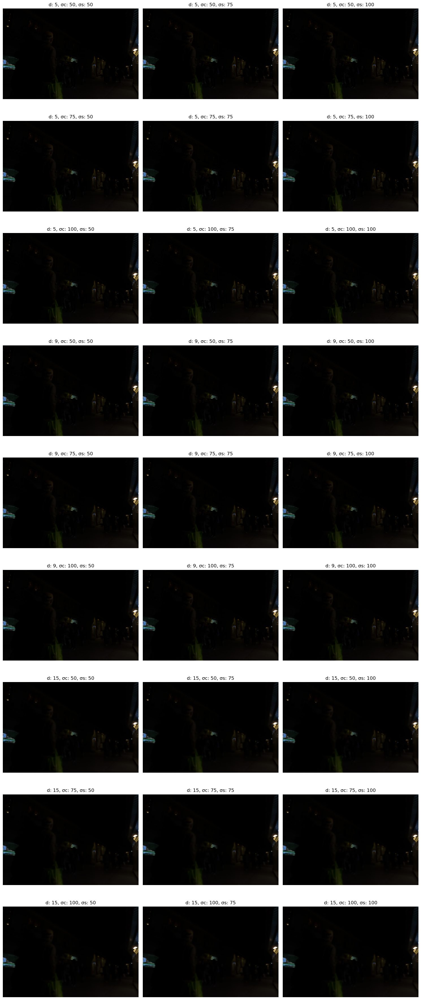

In [21]:
import math

# Parámetros a probar
d_values = [5, 9, 15]
sigma_color_values = [50, 75, 100]
sigma_space_values = [50, 75, 100]

# Crear combinaciones de parámetros
param_combinations = [(d, sc, ss) for d in d_values for sc in sigma_color_values for ss in sigma_space_values]

# Calcular el tamaño de la cuadrícula
num_combinations = len(param_combinations)
cols = 3  # Número de columnas fijas
rows = math.ceil(num_combinations / cols)  # Filas calculadas dinámicamente

# Aplicar filtro bilateral y mostrar las imágenes
plt.figure(figsize=(15, rows * 4))

for i, (d, sigma_c, sigma_s) in enumerate(param_combinations):
    img_bilateral = apply_bilateral_filter(images_rgb[2], d=d, sigma_color=sigma_c, sigma_space=sigma_s)
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img_bilateral)
    plt.title(f"d: {d}, σc: {sigma_c}, σs: {sigma_s}")
    plt.axis('off')

plt.tight_layout()
plt.show()


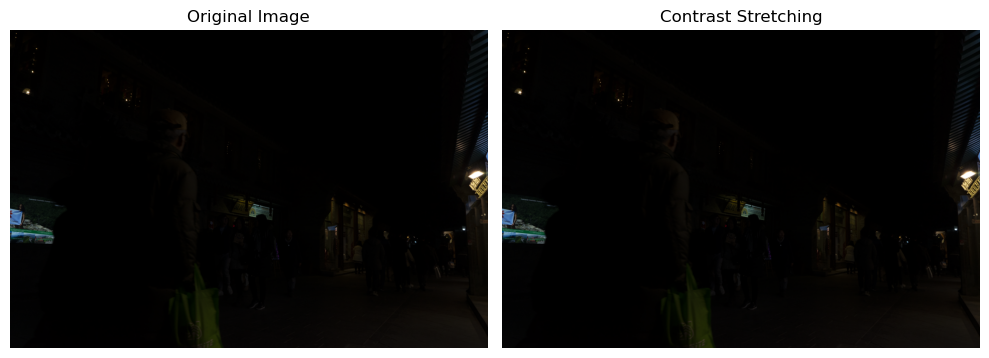

In [22]:
# Función para aplicar stretching lineal de histograma
def contrast_stretching(img_rgb):
    img_stretched = img_rgb.copy()
    for i in range(3):  # Iterar sobre los canales R, G, B
        min_val = np.min(img_rgb[:, :, i])
        max_val = np.max(img_rgb[:, :, i])
        img_stretched[:, :, i] = ((img_rgb[:, :, i] - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return img_stretched

# Aplicar stretching lineal a la imagen
contrast_stretched_image = contrast_stretching(images_rgb[2])

# Visualizar resultados
plt.figure(figsize=(10, 5))

# Imagen original
plt.subplot(1, 2, 1)
plt.imshow(images_rgb[2])
plt.title("Original Image")
plt.axis('off')

# Imagen con contraste lineal aplicado
plt.subplot(1, 2, 2)
plt.imshow(contrast_stretched_image)
plt.title("Contrast Stretching")
plt.axis('off')

plt.tight_layout()
plt.show()


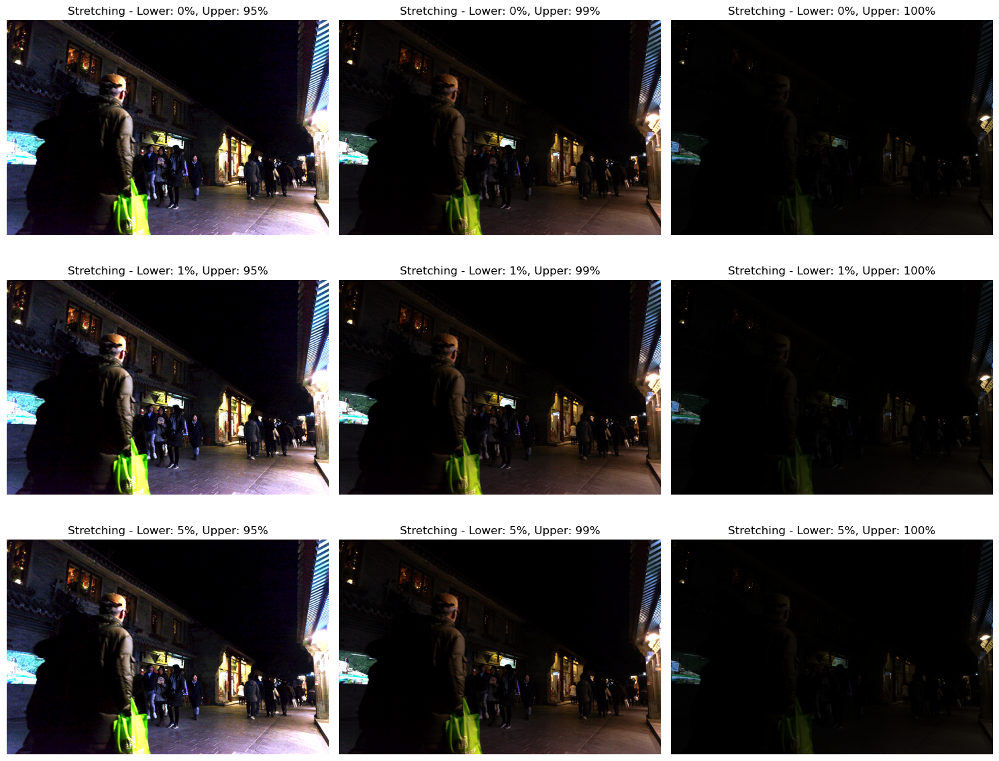

In [23]:
# Función de stretching lineal con umbrales ajustables
def contrast_stretching_parametric(img_rgb, lower_percent=1, upper_percent=99):
    img_stretched = img_rgb.copy()
    for i in range(3):  # Iterar sobre los canales R, G, B
        # Calcular límites de percentiles
        lower = np.percentile(img_rgb[:, :, i], lower_percent)
        upper = np.percentile(img_rgb[:, :, i], upper_percent)
        # Aplicar estiramiento lineal
        img_stretched[:, :, i] = np.clip((img_rgb[:, :, i] - lower) / (upper - lower) * 255, 0, 255).astype(np.uint8)
    return img_stretched

# Parámetros a probar
lower_bounds = [0, 1, 5]
upper_bounds = [95, 99, 100]

# Aplicar contrast stretching con varios parámetros
plt.figure(figsize=(15, 12))

for i, (lower, upper) in enumerate([(l, u) for l in lower_bounds for u in upper_bounds]):
    img_stretched = contrast_stretching_parametric(images_rgb[2], lower_percent=lower, upper_percent=upper)
    plt.subplot(len(lower_bounds), len(upper_bounds), i + 1)
    plt.imshow(img_stretched)
    plt.title(f"Stretching - Lower: {lower}%, Upper: {upper}%")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [24]:
# Función para sumar un valor constante a los píxeles de una imagen
def add_constant_brightness(img_rgb, constant):
    return np.clip(img_rgb + constant, 0, 255).astype(np.uint8)


In [25]:
# Función para aplicar la transformación logarítmica
def apply_log_transform(img_rgb, c=None):
    img_float = img_rgb.astype(float)
    if c is None:
        c = 255 / np.log(1 + np.max(img_float))  # Calcular c automáticamente
    img_log = c * np.log(1 + img_float)
    return np.clip(img_log, 0, 255).astype(np.uint8)


In [26]:
# Función para aplicar transformaciones definidas a trozos
def piecewise_transform(img_rgb, thresholds, functions):
    img_transformed = img_rgb.copy()
    for i in range(3):  # Aplicar a cada canal (R, G, B)
        channel = img_rgb[:, :, i]
        transformed_channel = np.zeros_like(channel)
        for (a, b), func in zip(thresholds, functions):
            mask = (channel >= a) & (channel <= b)
            transformed_channel[mask] = func(channel[mask])
        img_transformed[:, :, i] = transformed_channel
    return img_transformed


In [27]:
thresholds = [(0, 100), (101, 200), (201, 255)]
functions = [
    lambda x: x * 1.5,  # Incrementar brillo en rango bajo
    lambda x: x * 0.8,  # Reducir contraste en rango medio
    lambda x: x * 1.2   # Incrementar brillo en rango alto
]

In [28]:
# Función para invertir los valores de los píxeles de una imagen RGB
def invert_image(img_rgb):
    return 255 - img_rgb


In [29]:
# Función para aplicar umbralización a una imagen
def apply_threshold(img_rgb, threshold, inverse=False):
    # Convertir la imagen a escala de grises
    img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    
    # Aplicar el umbral
    if inverse:
        _, img_thresh = cv2.threshold(img_gray, threshold, 255, cv2.THRESH_BINARY_INV)
    else:
        _, img_thresh = cv2.threshold(img_gray, threshold, 255, cv2.THRESH_BINARY)
    
    return img_thresh


In [30]:
# Función para asegurar que las dimensiones coincidan con la original
def match_dimensions(img, reference_shape):
    if len(img.shape) == 2:  # Imagen en escala de grises
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    return cv2.resize(img, (reference_shape[1], reference_shape[0]))  # Ajustar dimensiones

# Ajustar dimensiones de todas las imágenes generadas
generated_images = {
    "Original": images_rgb[2],
    "Suma (C=50)": add_constant_brightness(images_rgb[2], 50),
    "Suma (C=100)": add_constant_brightness(images_rgb[2], 100),
    "Log Auto": apply_log_transform(images_rgb[2], c=None),
    "Log (c=40)": apply_log_transform(images_rgb[2], c=40),
    "Definida a Trozos": piecewise_transform(images_rgb[2], thresholds, functions),
    "Negativo": invert_image(images_rgb[2]),
    "Umbralización (T=100)": apply_threshold(images_rgb[2], threshold=100),
    "Umbralización (T=150)": apply_threshold(images_rgb[2], threshold=150)
}

# Asegurar dimensiones uniformes
original_shape = images_rgb[2].shape
for title in generated_images:
    generated_images[title] = match_dimensions(generated_images[title], original_shape)

# Calcular PSNR y SSIM
metrics = []

for title, img in generated_images.items():
    if title == "Original":  # Saltar la comparación de la original consigo misma
        continue
    psnr_value = psnr(images_rgb[2], img, data_range=255)
    ssim_value = ssim(images_rgb[2], img, channel_axis=2, data_range=255, win_size=7)
    metrics.append((title, psnr_value, ssim_value))

# Mostrar resultados
print(f"{'Técnica':<25} {'PSNR (dB)':<10} {'SSIM':<10}")
for title, psnr_value, ssim_value in metrics:
    print(f"{title:<25} {psnr_value:<10.2f} {ssim_value:<10.4f}")


Técnica                   PSNR (dB)  SSIM      
Suma (C=50)               14.11      0.1042    
Suma (C=100)              8.12       0.0569    
Log Auto                  13.61      0.2551    
Log (c=40)                15.01      0.2776    
Definida a Trozos         31.81      0.9687    
Negativo                  0.23       0.0064    
Umbralización (T=100)     27.26      0.6844    
Umbralización (T=150)     27.41      0.6818    


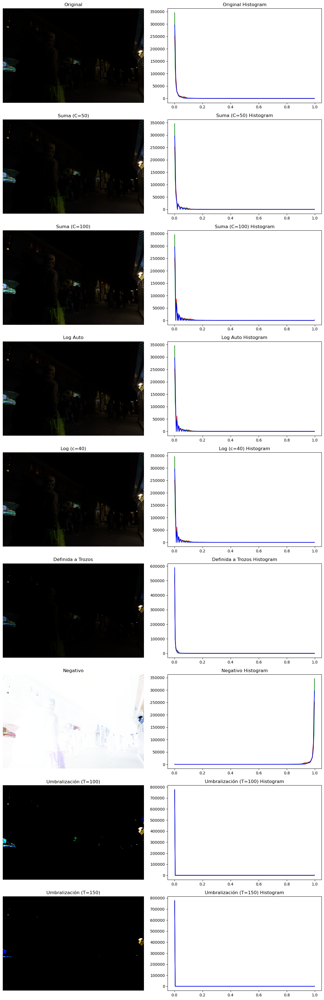

Técnica                   PSNR (dB)  SSIM      
Suma (C=50)               14.15      0.1060    
Suma (C=100)              8.13       0.0607    
Log Auto                  38.44      0.9727    
Log (c=40)                38.44      0.9727    
Definida a Trozos         33.17      0.8622    
Negativo                  0.23       0.0064    
Umbralización (T=100)     27.72      0.6846    
Umbralización (T=150)     27.97      0.6822    


In [31]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, exposure, color, util, filters
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

# Función para mostrar imágenes con histogramas
def show_image_and_histogram(images_dict):
    fig, axes = plt.subplots(len(images_dict), 2, figsize=(12, len(images_dict) * 4))

    for i, (title, img) in enumerate(images_dict.items()):
        # Asegurar que la imagen está en rango [0, 1] y float64
        img = exposure.rescale_intensity(img, out_range=(0, 1)).astype(np.float32)
        
        # Mostrar imagen
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(title)
        axes[i, 0].axis('off')
        
        # Mostrar histograma
        if img.ndim == 3:  # Imágenes RGB
            for channel, color_name in enumerate(['red', 'green', 'blue']):
                hist, bins = exposure.histogram(img[:, :, channel])
                axes[i, 1].plot(bins, hist, color=color_name)
        else:  # Imágenes en escala de grises
            hist, bins = exposure.histogram(img)
            axes[i, 1].plot(bins, hist, color='black')
        axes[i, 1].set_title(f"{title} Histogram")

    plt.tight_layout()
    plt.show()

# Funciones de transformaciones
def add_constant_brightness(img, constant):
    img = np.clip(img + constant / 255.0, 0, 1)  # Rango [0, 1]
    return img.astype(np.float32)

def apply_log_transform(img, c=1.0):
    img_log = c * np.log1p(img)
    return exposure.rescale_intensity(img_log, out_range=(0, 1)).astype(np.float32)

def piecewise_transform(img, thresholds, functions):
    img_transformed = np.zeros_like(img)
    for (a, b), func in zip(thresholds, functions):
        mask = (img >= a) & (img <= b)
        img_transformed[mask] = func(img[mask])
    return exposure.rescale_intensity(img_transformed, out_range=(0, 1)).astype(np.float32)

def invert_image(img):
    return util.invert(img).astype(np.float32)

def apply_threshold(img, threshold):
    return (img > (threshold / 255.0)).astype(np.float32)

# Cargar imagen con Scikit-Image
image_path = "./imagenes_proyecto/3246.png"
image_rgb = io.imread(image_path) / 255.0  # Normalización en [0, 1]

# Definición de imágenes generadas
thresholds = [(0, 0.3), (0.3, 0.7), (0.7, 1)]
functions = [lambda x: x * 0.5, lambda x: x, lambda x: x * 1.5]

generated_images = {
    "Original": image_rgb,
    "Suma (C=50)": add_constant_brightness(image_rgb, 50),
    "Suma (C=100)": add_constant_brightness(image_rgb, 100),
    "Log Auto": apply_log_transform(image_rgb),
    "Log (c=40)": apply_log_transform(image_rgb, c=40),
    "Definida a Trozos": piecewise_transform(image_rgb, thresholds, functions),
    "Negativo": invert_image(image_rgb),
    "Umbralización (T=100)": apply_threshold(image_rgb, threshold=100),
    "Umbralización (T=150)": apply_threshold(image_rgb, threshold=150)
}

# Mostrar imágenes y sus histogramas
show_image_and_histogram(generated_images)

# Calcular PSNR y SSIM
metrics = []
for title, img in generated_images.items():
    if title == "Original":
        continue
    psnr_value = psnr(image_rgb, img, data_range=1)
    ssim_value = ssim(image_rgb, img, channel_axis=2, data_range=1)
    metrics.append((title, psnr_value, ssim_value))

# Mostrar resultados de PSNR y SSIM
print(f"{'Técnica':<25} {'PSNR (dB)':<10} {'SSIM':<10}")
for title, psnr_value, ssim_value in metrics:
    print(f"{title:<25} {psnr_value:<10.2f} {ssim_value:<10.4f}")


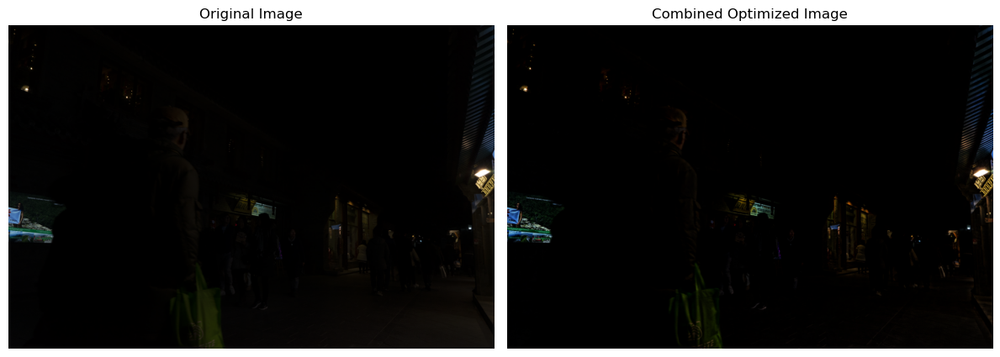

In [39]:
from skimage import exposure, img_as_float, img_as_ubyte
import matplotlib.pyplot as plt
import numpy as np

# Paso 1: CLAHE para mejorar el contraste
def apply_clahe(image, clip_limit=0.01, grid_size=(8, 8)):
    clahe = exposure.equalize_adapthist(image, clip_limit=clip_limit, kernel_size=grid_size)
    return img_as_ubyte(clahe)

# Paso 2: Corrección Gamma
def gamma_correction(image, gamma=1.5):
    return exposure.adjust_gamma(image, gamma=gamma)

# Paso 3: Transformación Logarítmica
def log_transform(image):
    return exposure.adjust_log(image)

# Paso 4: Balance de blancos (opcional)
def balance_white(image):
    result = image.copy()
    for i in range(3):  # Iterar por los canales R, G, B
        result[..., i] = exposure.rescale_intensity(image[..., i])
    return result

# Imagen original como float
image_float = img_as_float(images_rgb[2])

# Aplicar las transformaciones
clahe_image = apply_clahe(image_float)
gamma_image = gamma_correction(clahe_image, gamma=1.8)
final_image = log_transform(gamma_image)
balanced_image = balance_white(final_image)

# Mostrar el resultado final
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(images_rgb[2])
axes[0].set_title("Original Image")
axes[0].axis('off')

axes[1].imshow(balanced_image)
axes[1].set_title("Combined Optimized Image")
axes[1].axis('off')

plt.tight_layout()
plt.show()


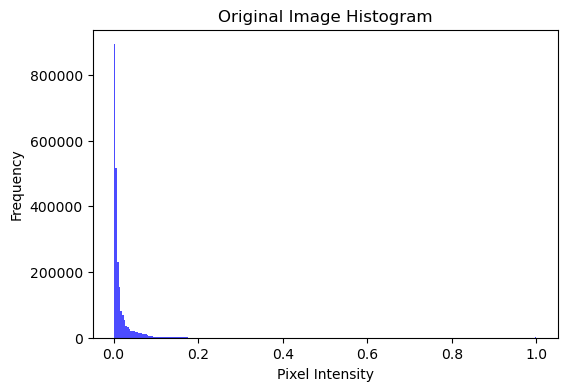

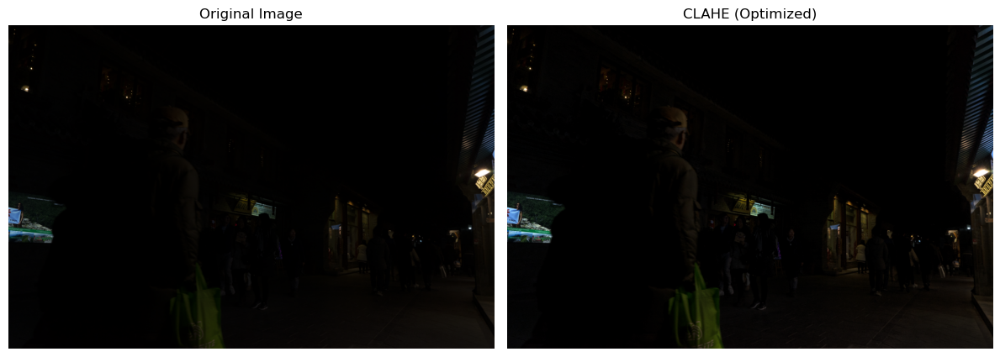

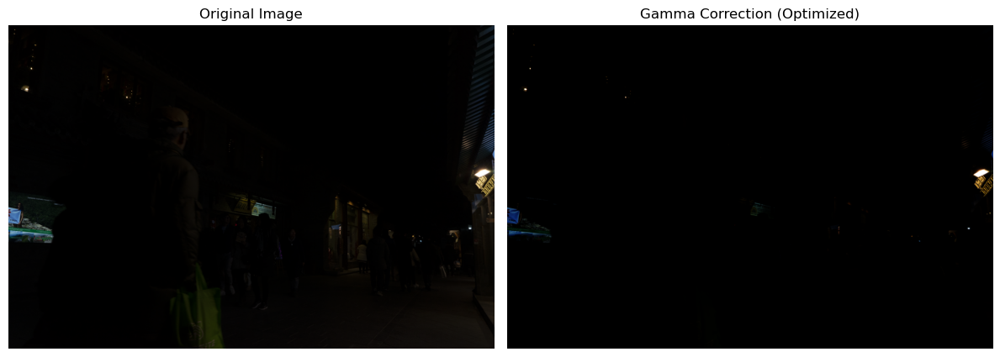

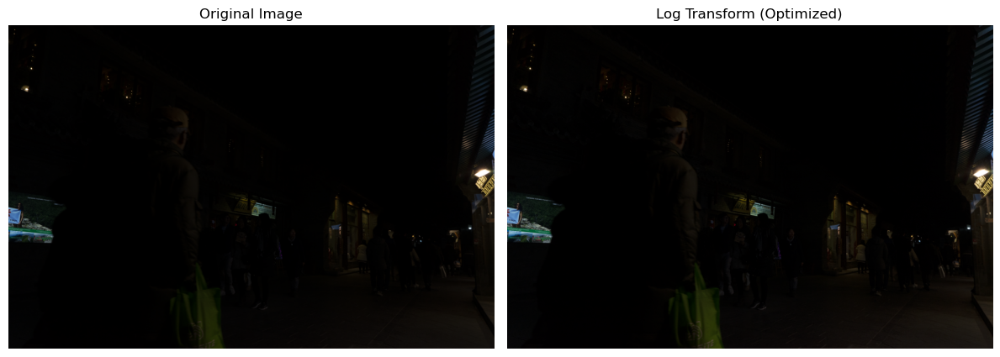

In [41]:
from skimage import exposure, img_as_float, img_as_ubyte
import matplotlib.pyplot as plt
import numpy as np

# Paso 1: Mostrar histograma de la imagen original
def plot_histogram(image, title="Histogram"):
    plt.figure(figsize=(6, 4))
    plt.hist(image.ravel(), bins=256, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")
    plt.show()

# Transformaciones con parámetros óptimos
def optimize_and_apply_clahe(image):
    return exposure.equalize_adapthist(image, clip_limit=0.01, kernel_size=(16, 16))

def optimize_and_apply_gamma(image):
    gamma_opt = 2.5  # Ajuste manual según el histograma
    return exposure.adjust_gamma(image, gamma=gamma_opt)

def optimize_and_apply_log(image):
    return exposure.adjust_log(image)

# Visualización Comparativa
def show_comparison(original, processed, title):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(original)
    axes[0].set_title("Original Image")
    axes[0].axis('off')
    axes[1].imshow(processed)
    axes[1].set_title(title)
    axes[1].axis('off')
    plt.tight_layout()
    plt.show()

# Imagen original
image_float = img_as_float(images_rgb[2])

# Mostrar histograma original
plot_histogram(image_float, title="Original Image Histogram")

# Aplicar transformaciones optimizadas
clahe_image = optimize_and_apply_clahe(image_float)
gamma_image = optimize_and_apply_gamma(image_float)
log_image = optimize_and_apply_log(image_float)

# Mostrar resultados
show_comparison(image_float, clahe_image, "CLAHE (Optimized)")
show_comparison(image_float, gamma_image, "Gamma Correction (Optimized)")
show_comparison(image_float, log_image, "Log Transform (Optimized)")


<h1>PIPELINE</h1>

In [34]:
from skimage import io

# Cargar imágenes RGB
images_rgb = [io.imread("./imagenes_proyecto/1717.png"), io.imread("./imagenes_proyecto/2242.png"), io.imread("./imagenes_proyecto/3246.png"), io.imread("./imagenes_proyecto/3302.png")]


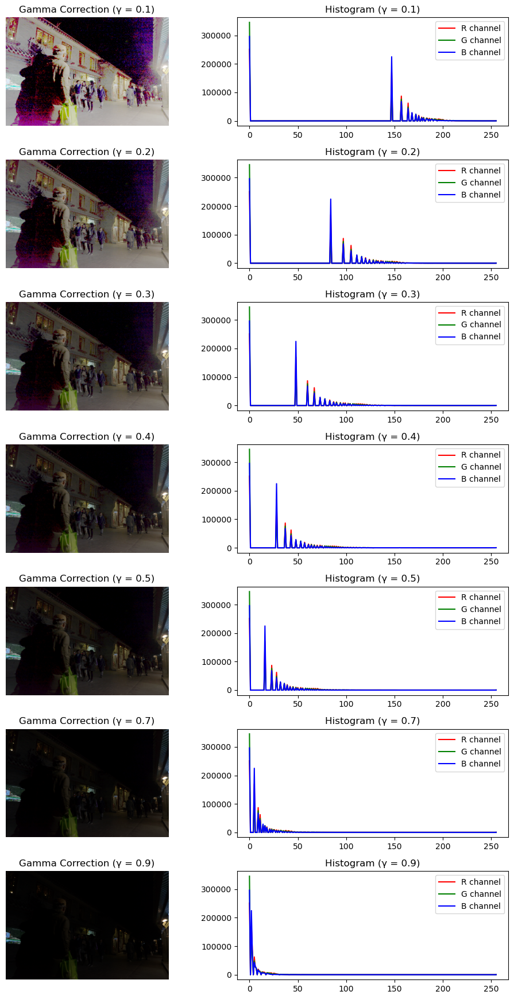

In [35]:
import matplotlib.pyplot as plt
from skimage import exposure
import numpy as np

# Lista de valores gamma
gamma_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9]

# Aplicar gamma correction y mostrar resultados con histogramas
fig, axes = plt.subplots(len(gamma_values), 2, figsize=(10, len(gamma_values) * 2.5))

for i, gamma in enumerate(gamma_values):
    # Aplicar gamma correction
    corrected_image = exposure.adjust_gamma(images_rgb[2], gamma)
    
    # Obtener histograma de la imagen
    hist_r, bins_r = exposure.histogram(corrected_image[:, :, 0])  # Canal R
    hist_g, bins_g = exposure.histogram(corrected_image[:, :, 1])  # Canal G
    hist_b, bins_b = exposure.histogram(corrected_image[:, :, 2])  # Canal B
    
    # Mostrar imagen corregida
    axes[i, 0].imshow(corrected_image)
    axes[i, 0].set_title(f"Gamma Correction (γ = {gamma})")
    axes[i, 0].axis("off")
    
    # Mostrar histograma
    axes[i, 1].plot(bins_r, hist_r, color="red", label="R channel")
    axes[i, 1].plot(bins_g, hist_g, color="green", label="G channel")
    axes[i, 1].plot(bins_b, hist_b, color="blue", label="B channel")
    axes[i, 1].set_title(f"Histogram (γ = {gamma})")
    axes[i, 1].legend()

plt.tight_layout()
plt.show()


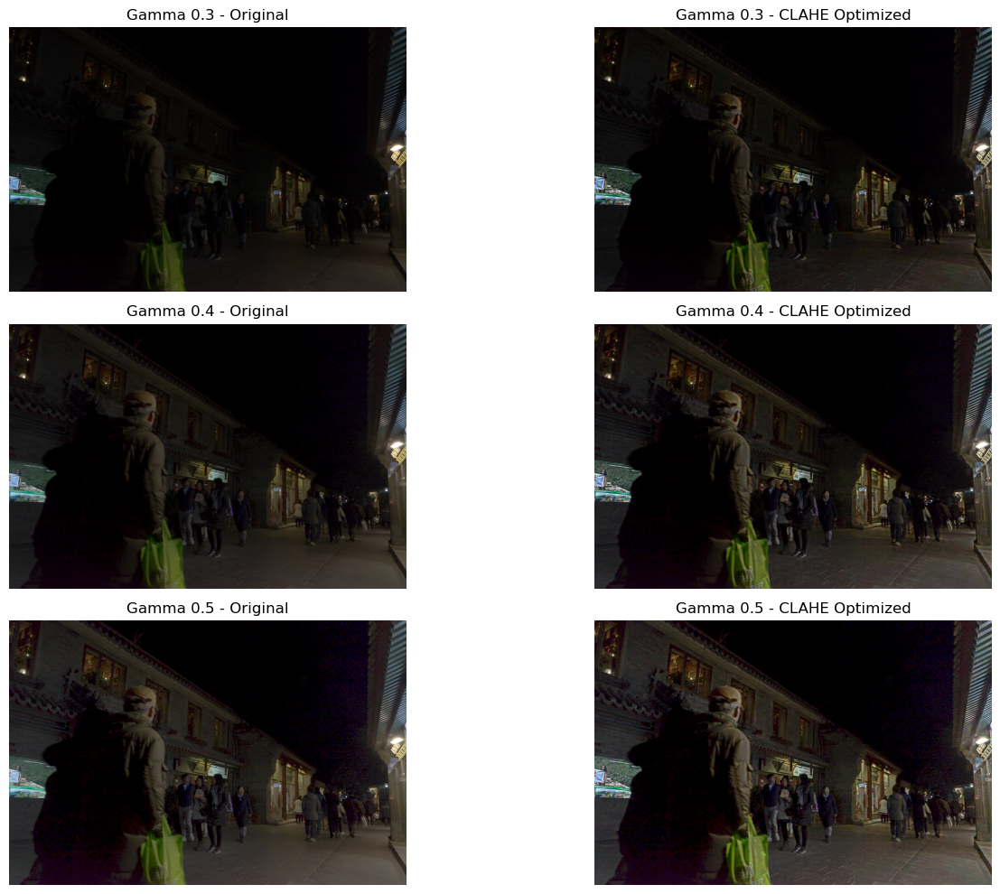

In [45]:
from skimage.exposure import equalize_adapthist
import numpy as np
import matplotlib.pyplot as plt

# Valores de gamma que se aplicaron en orden
gamma_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9]  # Ajusta según el orden de procesamiento
gamma_corrected_images_dict = {gamma: img for gamma, img in zip(gamma_values, gamma_corrected_images)}

# Función para aplicar CLAHE utilizando scikit-image
def apply_clahe_rgb_skimage(img_rgb, clip_limit=0.03, tile_grid_size=(8, 8)):
    img_rgb = img_rgb / 255.0  # Normalizar a [0, 1]
    r_eq = equalize_adapthist(img_rgb[:, :, 0], clip_limit=clip_limit, kernel_size=tile_grid_size)
    g_eq = equalize_adapthist(img_rgb[:, :, 1], clip_limit=clip_limit, kernel_size=tile_grid_size)
    b_eq = equalize_adapthist(img_rgb[:, :, 2], clip_limit=clip_limit, kernel_size=tile_grid_size)
    return (np.dstack((r_eq, g_eq, b_eq)) * 255).astype('uint8')

# Filtrar imágenes con gamma 0.3, 0.4 y 0.5
selected_gammas = [0.3, 0.4, 0.5]
gamma_images = {f"Gamma {gamma}": gamma_corrected_images_dict[gamma] for gamma in selected_gammas}

# Procesar y visualizar las imágenes originales y CLAHE
plt.figure(figsize=(15, 10))
for i, (title, img) in enumerate(gamma_images.items()):
    # Aplicar CLAHE
    clahe_image = apply_clahe_rgb_skimage(img, clip_limit=0.03, tile_grid_size=(8, 8))
    
    # Mostrar la imagen original
    plt.subplot(3, 2, 2 * i + 1)
    plt.imshow(img)
    plt.title(f"{title} - Original")
    plt.axis('off')
    
    # Mostrar la imagen mejorada con CLAHE
    plt.subplot(3, 2, 2 * i + 2)
    plt.imshow(clahe_image)
    plt.title(f"{title} - CLAHE Optimized")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [46]:
import os
from skimage.io import imsave

# Crear la carpeta si no existe
output_folder = "./imagenes_transformadas/3246/pipeline_after_clahe"
os.makedirs(output_folder, exist_ok=True)

# Guardar las imágenes mejoradas
output_paths = []
for gamma, img in gamma_images.items():
    filename = f"{gamma.replace(' ', '_')}_CLAHE_optimized.png"
    output_path = os.path.join(output_folder, filename)
    imsave(output_path, img)
    output_paths.append(output_path)
    print(f"Imagen guardada: {output_path}")


Imagen guardada: ./imagenes_transformadas/3246/pipeline_after_clahe/Gamma_0.3_CLAHE_optimized.png
Imagen guardada: ./imagenes_transformadas/3246/pipeline_after_clahe/Gamma_0.4_CLAHE_optimized.png
Imagen guardada: ./imagenes_transformadas/3246/pipeline_after_clahe/Gamma_0.5_CLAHE_optimized.png


Imagen guardada: ./imagenes_transformadas/3246/pipeline_after_stretching/stretched_Gamma_0.3_CLAHE_optimized.png
Imagen guardada: ./imagenes_transformadas/3246/pipeline_after_stretching/stretched_Gamma_0.4_CLAHE_optimized.png
Imagen guardada: ./imagenes_transformadas/3246/pipeline_after_stretching/stretched_Gamma_0.5_CLAHE_optimized.png


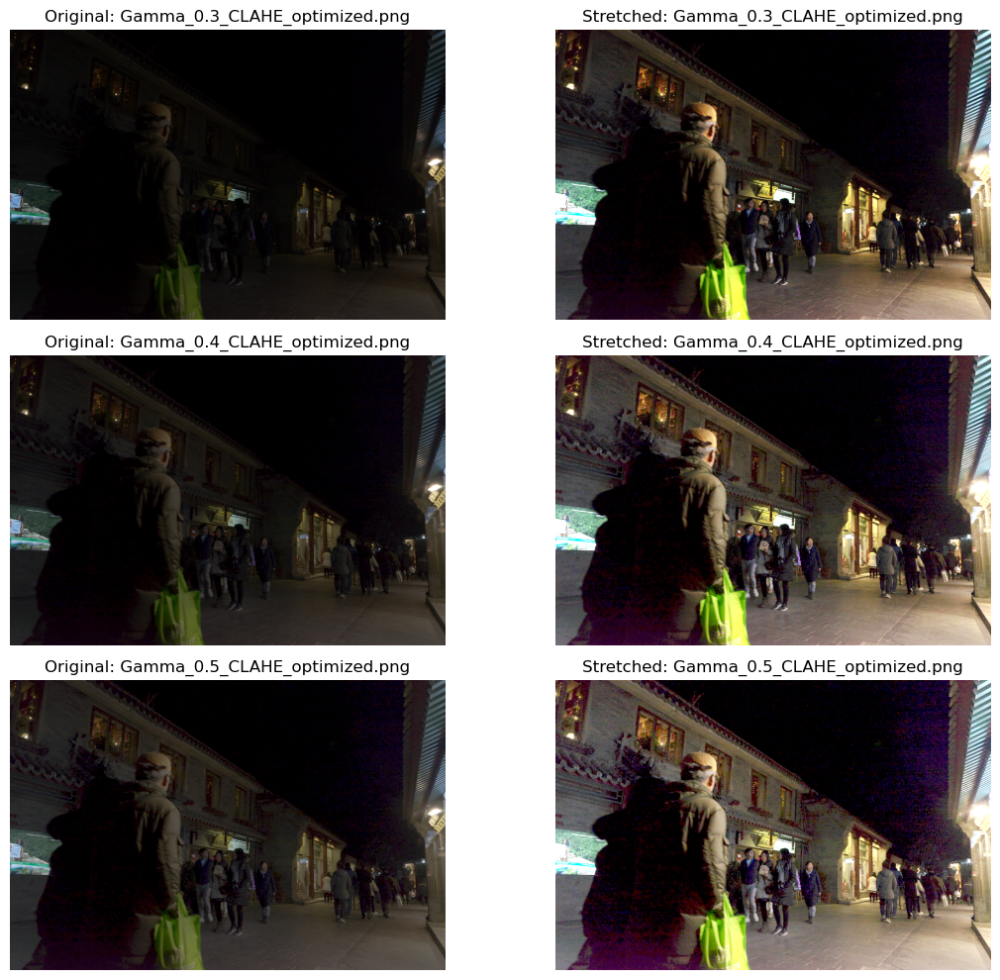

In [48]:
from skimage import exposure, io
import matplotlib.pyplot as plt

# Directorio de imágenes
input_folder = "./imagenes_transformadas/3246/pipeline_after_clahe"
output_folder = "./imagenes_transformadas/3246/pipeline_after_stretching"
os.makedirs(output_folder, exist_ok=True)

# Función de estiramiento de contraste
def apply_contrast_stretching(image):
    p2, p98 = np.percentile(image, (2, 98))  # Estiramiento entre percentiles 2% y 98%
    return exposure.rescale_intensity(image, in_range=(p2, p98))

# Procesar y guardar las imágenes
stretching_results = {}
for filename in os.listdir(input_folder):
    if filename.endswith(".png"):
        img_path = os.path.join(input_folder, filename)
        img = io.imread(img_path)
        
        # Aplicar estiramiento
        stretched_img = apply_contrast_stretching(img)
        
        # Guardar imagen procesada
        output_path = os.path.join(output_folder, f"stretched_{filename}")
        io.imsave(output_path, stretched_img)
        
        # Guardar en el diccionario y mostrar
        stretching_results[filename] = stretched_img
        print(f"Imagen guardada: {output_path}")

# Visualizar resultados
fig, axes = plt.subplots(len(stretching_results), 2, figsize=(12, 10))
for i, (filename, img) in enumerate(stretching_results.items()):
    original = io.imread(os.path.join(input_folder, filename))
    
    axes[i, 0].imshow(original)
    axes[i, 0].set_title(f"Original: {filename}")
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(img)
    axes[i, 1].set_title(f"Stretched: {filename}")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


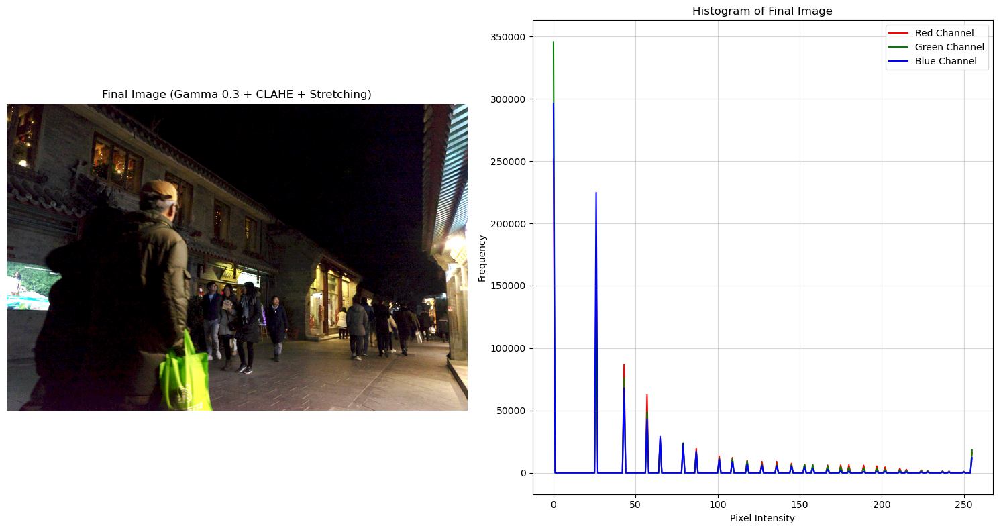

In [53]:
import matplotlib.pyplot as plt
from skimage import io, exposure
import numpy as np

# Cargar la imagen final seleccionada con scikit-image
final_image_path = "./imagenes_transformadas/3246/pipeline_after_stretching/stretched_Gamma_0.3_CLAHE_optimized.png"
final_image = io.imread(final_image_path)

# Calcular histogramas para cada canal R, G, B
r_hist, r_bins = exposure.histogram(final_image[:, :, 0], nbins=256)
g_hist, g_bins = exposure.histogram(final_image[:, :, 1], nbins=256)
b_hist, b_bins = exposure.histogram(final_image[:, :, 2], nbins=256)

# Visualizar imagen y sus histogramas
plt.figure(figsize=(15, 8))

# Imagen final seleccionada
plt.subplot(1, 2, 1)
plt.imshow(final_image)
plt.title("Final Image (Gamma 0.3 + CLAHE + Stretching)")
plt.axis('off')

# Histograma
plt.subplot(1, 2, 2)
plt.plot(r_bins, r_hist, color='red', label='Red Channel')
plt.plot(g_bins, g_hist, color='green', label='Green Channel')
plt.plot(b_bins, b_hist, color='blue', label='Blue Channel')
plt.title("Histogram of Final Image")
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")
plt.legend()
plt.grid(alpha=0.5)  # Opcional: añade grid suave al histograma

plt.tight_layout()
plt.show()

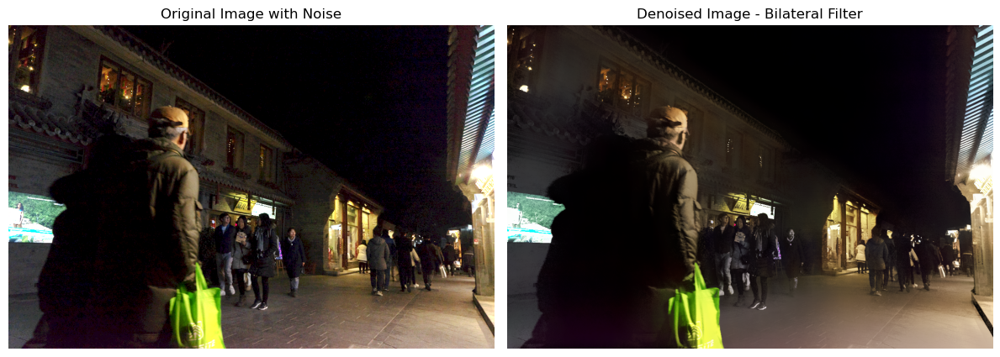

In [55]:
from skimage.restoration import denoise_bilateral
import matplotlib.pyplot as plt
from skimage import img_as_float, io

# Cargar la imagen final en formato RGB
final_image_path = "./imagenes_transformadas/3246/pipeline_after_stretching/stretched_Gamma_0.3_CLAHE_optimized.png"
final_image = io.imread(final_image_path)

# Convertimos la imagen a float [0, 1] para un procesamiento adecuado
final_image_float = img_as_float(final_image)

# Aplicar filtro bilateral con channel_axis=2 para imágenes RGB
denoised_image = denoise_bilateral(final_image_float, sigma_color=0.05, sigma_spatial=15, channel_axis=-1)

# Visualizar resultados
plt.figure(figsize=(12, 6))

# Imagen original
plt.subplot(1, 2, 1)
plt.imshow(final_image)
plt.title("Original Image with Noise")
plt.axis('off')

# Imagen suavizada
plt.subplot(1, 2, 2)
plt.imshow(denoised_image)
plt.title("Denoised Image - Bilateral Filter")
plt.axis('off')

plt.tight_layout()
plt.show()


In [56]:
import os
import matplotlib.pyplot as plt
from skimage import io, exposure, img_as_float, img_as_ubyte
import numpy as np

# Definir los valores de gamma correction
gamma_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9]
input_folder = "./imagenes_proyecto"
output_folder = "./imagenes_transformadas"

# Lista de imágenes a procesar
image_files = ["1717.png", "2242.png", "3302.png"]

# Función para aplicar gamma correction
def apply_gamma_correction(image, gamma):
    return exposure.adjust_gamma(image, gamma)

# Procesar todas las imágenes
results = {}
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)
    image_name = os.path.splitext(image_file)[0]
    image = io.imread(image_path)

    # Crear carpeta para almacenar transformaciones de esta imagen
    save_path = os.path.join(output_folder, image_name)
    os.makedirs(save_path, exist_ok=True)

    # Aplicar gamma correction para cada valor de gamma
    results[image_name] = {}
    for gamma in gamma_values:
        gamma_corrected = apply_gamma_correction(img_as_float(image), gamma)
        gamma_corrected_uint8 = img_as_ubyte(gamma_corrected)  # Convertir a uint8 para guardado
        save_filename = f"gamma_{gamma}.png"
        full_save_path = os.path.join(save_path, save_filename)
        io.imsave(full_save_path, gamma_corrected_uint8)

        # Almacenar en el diccionario de resultados
        results[image_name][gamma] = gamma_corrected_uint8

# Retornar diccionario con resultados y carpeta de guardado
results.keys()

dict_keys(['1717', '2242', '3302'])

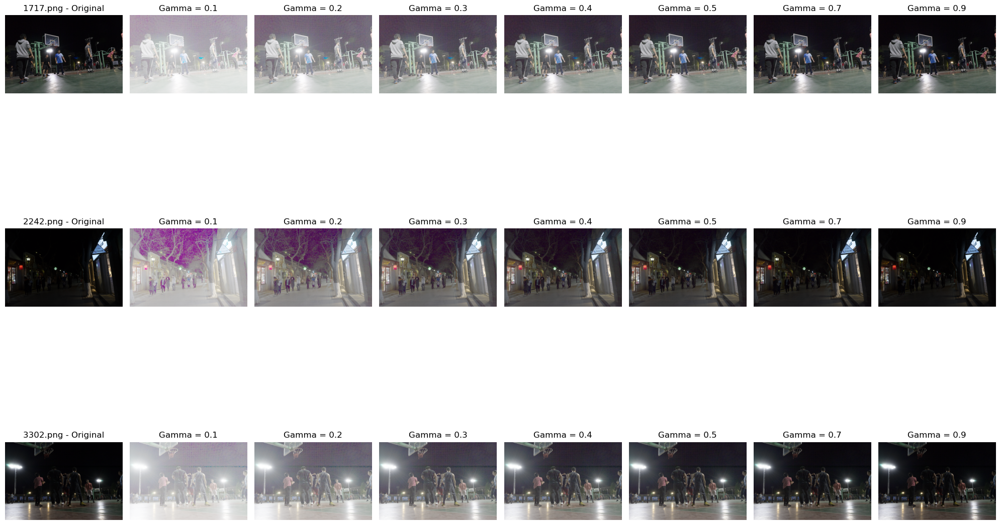

In [57]:
import os
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.exposure import adjust_gamma

# Parámetros iniciales
gamma_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9]
input_dir = "./imagenes_proyecto"
output_dir = "./imagenes_transformadas"

# Lista de imágenes
image_names = ["1717.png", "2242.png", "3302.png"]
images_gamma = {}

# Cargar y aplicar gamma correction a todas las imágenes
for image_name in image_names:
    image_path = os.path.join(input_dir, image_name)
    img = imread(image_path)
    images_gamma[image_name] = {}
    
    # Generar imágenes para cada valor de gamma
    for gamma in gamma_values:
        adjusted_img = adjust_gamma(img, gamma)
        images_gamma[image_name][gamma] = adjusted_img

# Visualizar todas las imágenes generadas
fig, axes = plt.subplots(len(image_names), len(gamma_values) + 1, figsize=(20, 15))

for row_idx, (image_name, gamma_dict) in enumerate(images_gamma.items()):
    # Imagen original en la primera columna
    axes[row_idx, 0].imshow(imread(os.path.join(input_dir, image_name)))
    axes[row_idx, 0].set_title(f"{image_name} - Original")
    axes[row_idx, 0].axis('off')

    # Imágenes ajustadas para cada gamma
    for col_idx, gamma in enumerate(gamma_values, start=1):
        axes[row_idx, col_idx].imshow(gamma_dict[gamma])
        axes[row_idx, col_idx].set_title(f"Gamma = {gamma}")
        axes[row_idx, col_idx].axis('off')

plt.tight_layout()
plt.show()

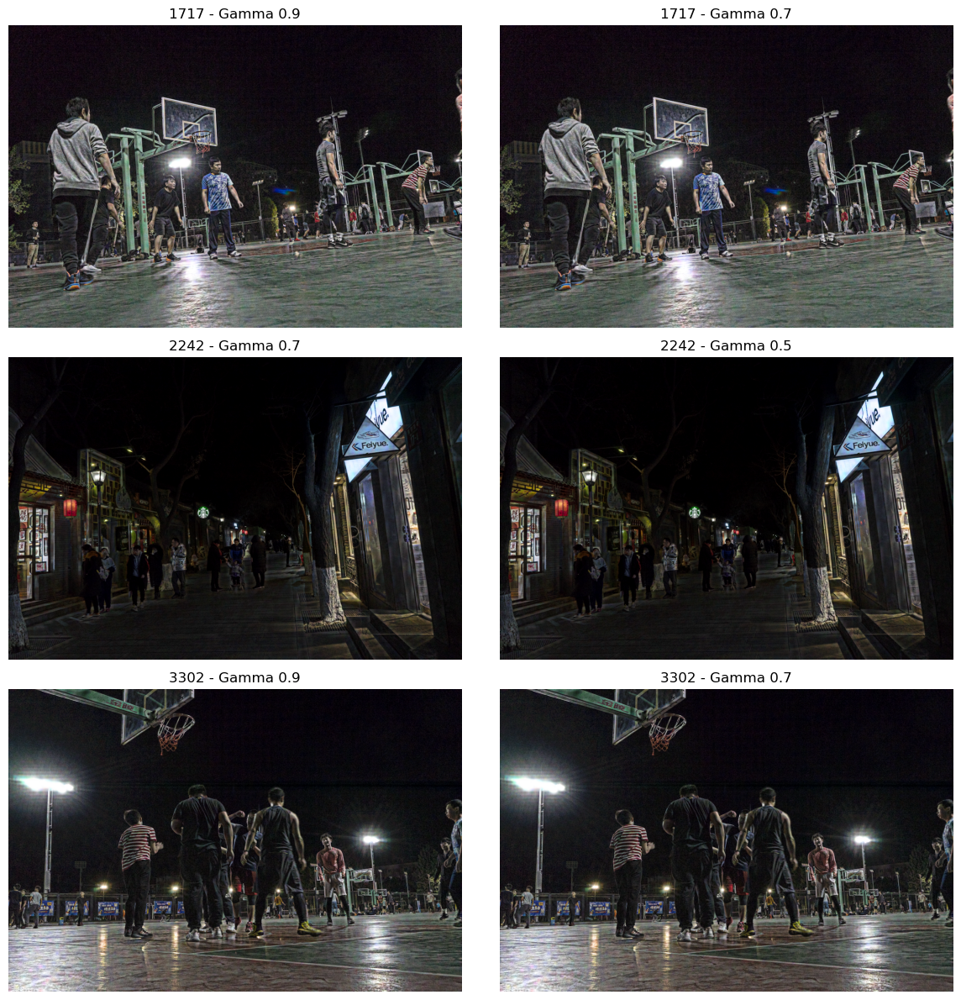

In [58]:
import os
from skimage import io, exposure, img_as_float
import matplotlib.pyplot as plt

# Crear la función para aplicar CLAHE en el espacio RGB
def apply_clahe_rgb_skimage(img_rgb, clip_limit=0.03, tile_grid_size=(8, 8)):
    """Aplica CLAHE en el espacio RGB usando scikit-image."""
    img_rgb = img_rgb / 255.0
    r_eq = exposure.equalize_adapthist(img_rgb[:, :, 0], clip_limit=clip_limit, kernel_size=tile_grid_size)
    g_eq = exposure.equalize_adapthist(img_rgb[:, :, 1], clip_limit=clip_limit, kernel_size=tile_grid_size)
    b_eq = exposure.equalize_adapthist(img_rgb[:, :, 2], clip_limit=clip_limit, kernel_size=tile_grid_size)
    return (np.dstack((r_eq, g_eq, b_eq)) * 255).astype('uint8')

# Definir las imágenes y sus valores de gamma seleccionados
gamma_selected = {
    "1717": [0.9, 0.7],
    "2242": [0.7, 0.5],
    "3302": [0.9, 0.7]
}

input_folder = "./imagenes_proyecto"
output_folder = "./imagenes_transformadas"

# Aplicar CLAHE optimizado a las imágenes seleccionadas
clahe_results = {}

for img_name, gammas in gamma_selected.items():
    img_path = os.path.join(input_folder, f"{img_name}.png")
    img = io.imread(img_path)
    
    clahe_results[img_name] = {}
    
    for gamma in gammas:
        # Aplicar CLAHE optimizado
        clahe_image = apply_clahe_rgb_skimage(img, clip_limit=0.03, tile_grid_size=(8, 8))
        
        # Guardar la imagen procesada
        save_folder = os.path.join(output_folder, img_name, "CLAHE")
        os.makedirs(save_folder, exist_ok=True)
        save_path = os.path.join(save_folder, f"Gamma_{gamma}_CLAHE_optimized.png")
        io.imsave(save_path, clahe_image)
        
        # Almacenar el resultado temporal para mostrar luego
        clahe_results[img_name][f"Gamma {gamma}"] = clahe_image

# Mostrar resultados
fig, axs = plt.subplots(len(gamma_selected), 2, figsize=(12, 12))

for i, (img_name, images) in enumerate(clahe_results.items()):
    for j, (gamma_title, image) in enumerate(images.items()):
        axs[i, j].imshow(image)
        axs[i, j].axis("off")
        axs[i, j].set_title(f"{img_name} - {gamma_title}")

plt.tight_layout()
plt.show()

In [60]:
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import numpy as np
import os
from skimage.io import imread

# Función para calcular PSNR y SSIM con ajuste de win_size
def calculate_metrics(original, transformed):
    # Calcular PSNR
    psnr_value = psnr(original, transformed, data_range=transformed.max() - transformed.min())
    
    # Ajustar win_size para SSIM
    min_dim = min(original.shape[:2])
    win_size = min(7, min_dim)  # Si la imagen es pequeña, ajustamos win_size a la menor dimensión
    
    # Calcular SSIM
    ssim_value = ssim(original, transformed, channel_axis=-1, win_size=win_size, 
                      data_range=transformed.max() - transformed.min())
    return psnr_value, ssim_value

# Rutas de imágenes
original_folder = "./imagenes_proyecto"
transformed_folder = "./imagenes_transformadas"
selected_gammas = {"1717.png": [0.9, 0.7], "2242.png": [0.7, 0.5], "3302.png": [0.9, 0.7]}

# Calcular métricas
results = {}
for img_name, gammas in selected_gammas.items():
    results[img_name] = []
    original_path = os.path.join(original_folder, img_name)
    original_image = imread(original_path)

    for gamma in gammas:
        # Cargar imagen transformada
        transformed_path = os.path.join(transformed_folder, img_name.split('.')[0],
                                        f"Gamma_{gamma}.png")
        transformed_image = imread(transformed_path)
        
        # Calcular métricas
        psnr_value, ssim_value = calculate_metrics(original_image, transformed_image)
        results[img_name].append((gamma, psnr_value, ssim_value))

# Mostrar resultados
for img_name, metrics in results.items():
    print(f"\nResultados para {img_name}:")
    for gamma, psnr_val, ssim_val in metrics:
        print(f"  Gamma: {gamma} | PSNR: {psnr_val:.2f} | SSIM: {ssim_val:.4f}")



Resultados para 1717.png:
  Gamma: 0.9 | PSNR: 31.71 | SSIM: 0.9627
  Gamma: 0.7 | PSNR: 20.78 | SSIM: 0.7465

Resultados para 2242.png:
  Gamma: 0.7 | PSNR: 24.01 | SSIM: 0.6281
  Gamma: 0.5 | PSNR: 16.75 | SSIM: 0.3300

Resultados para 3302.png:
  Gamma: 0.9 | PSNR: 32.77 | SSIM: 0.9585
  Gamma: 0.7 | PSNR: 21.54 | SSIM: 0.7190


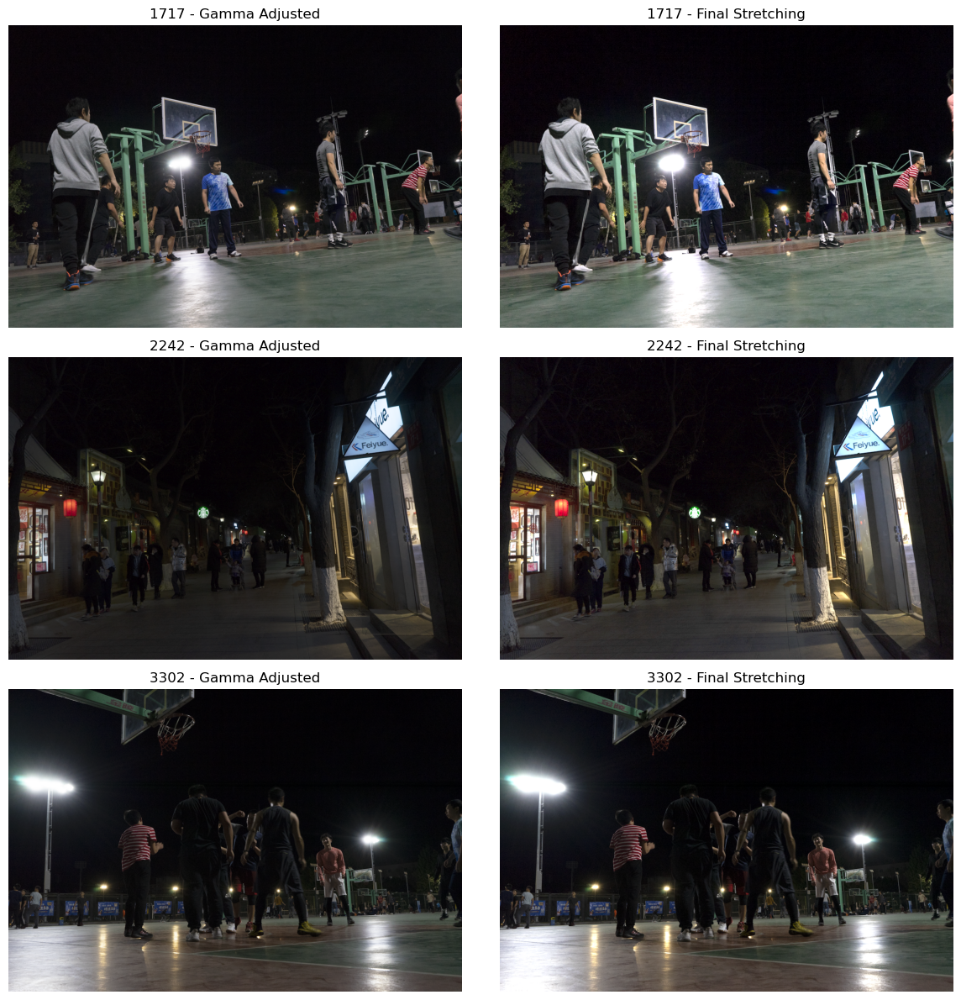

{'1717': (array([[[ 2,  2,  0],
          [11,  9,  9],
          [16, 11, 13],
          ...,
          [10,  9, 10],
          [11,  9,  9],
          [ 9, 10,  6]],
  
         [[ 9,  7,  6],
          [11,  7,  7],
          [13,  7,  9],
          ...,
          [ 7,  6,  6],
          [10, 10, 10],
          [10, 10,  9]],
  
         [[ 6,  6,  5],
          [11,  9,  9],
          [ 9,  5,  6],
          ...,
          [ 6,  5,  6],
          [ 9,  9,  9],
          [10, 10,  9]],
  
         ...,
  
         [[77, 85, 79],
          [73, 83, 76],
          [79, 89, 82],
          ...,
          [86, 94, 90],
          [88, 96, 92],
          [88, 96, 91]],
  
         [[80, 88, 82],
          [79, 88, 81],
          [73, 85, 78],
          ...,
          [88, 94, 92],
          [86, 92, 91],
          [90, 94, 95]],
  
         [[73, 83, 75],
          [78, 87, 80],
          [77, 87, 80],
          ...,
          [89, 94, 94],
          [89, 93, 94],
          [89, 92, 95]]],

In [62]:
import os
from skimage import exposure, io
import matplotlib.pyplot as plt

# Definir las imágenes seleccionadas
selected_images = {
    "1717": "./imagenes_transformadas/1717/Gamma_0.9.png",
    "2242": "./imagenes_transformadas/2242/Gamma_0.7.png",
    "3302": "./imagenes_transformadas/3302/Gamma_0.9.png"
}

# Carpeta de salida para los resultados finales
output_base_folder = "./imagenes_transformadas"

# Aplicar stretching y guardar las imágenes
final_results = {}
for img_name, img_path in selected_images.items():
    # Cargar la imagen
    img = io.imread(img_path)
    
    # Aplicar stretching usando scikit-image
    p2, p98 = np.percentile(img, (2, 98))
    stretched = exposure.rescale_intensity(img, in_range=(p2, p98))
    
    # Guardar la imagen
    output_folder = os.path.join(output_base_folder, img_name, "final_pipeline_stretching")
    os.makedirs(output_folder, exist_ok=True)
    output_path = os.path.join(output_folder, f"Gamma_{img_name}_stretched.png")
    io.imsave(output_path, stretched)
    
    # Almacenar para visualización
    final_results[img_name] = (img, stretched, output_path)

# Mostrar resultados por pantalla
fig, axes = plt.subplots(3, 2, figsize=(12, 12))
for i, (img_name, (original, stretched, _)) in enumerate(final_results.items()):
    axes[i, 0].imshow(original)
    axes[i, 0].set_title(f"{img_name} - Gamma Adjusted")
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(stretched)
    axes[i, 1].set_title(f"{img_name} - Final Stretching")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()

final_results


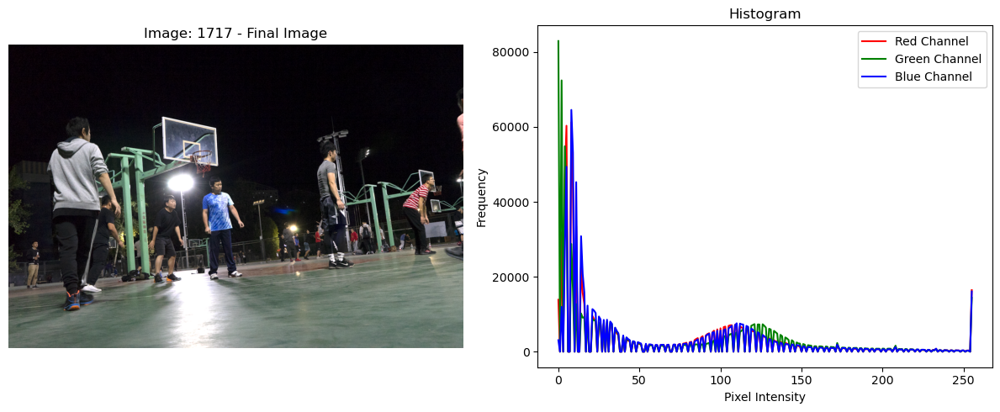

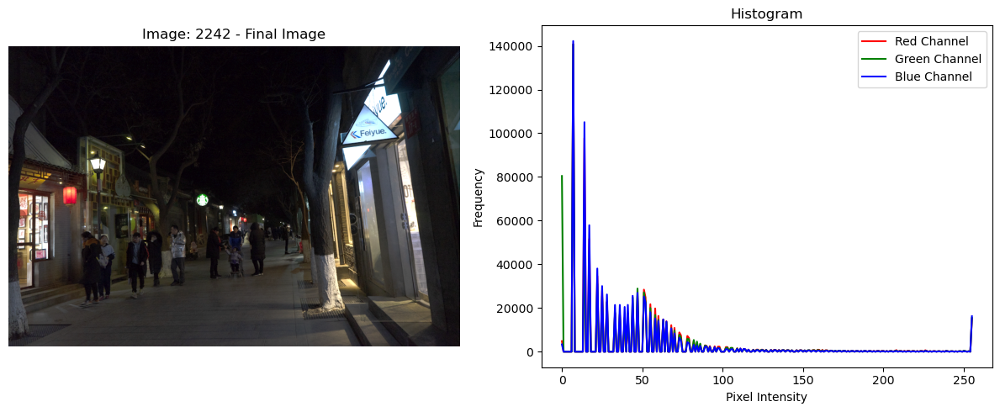

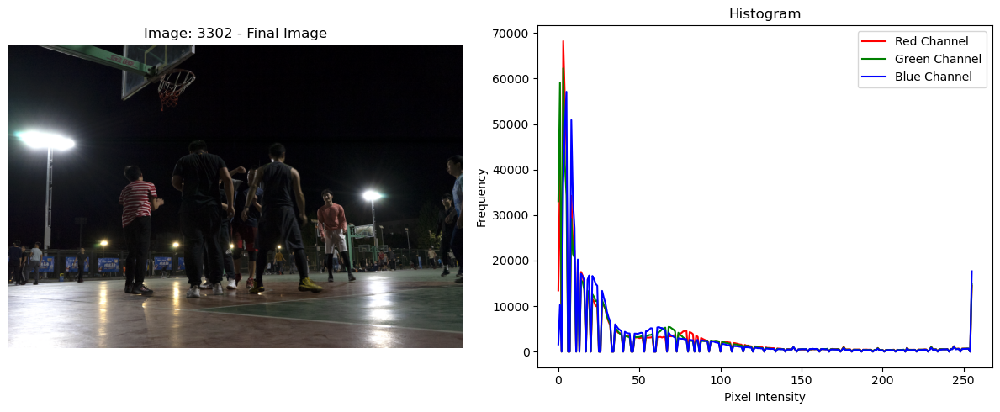

In [64]:
import matplotlib.pyplot as plt
import numpy as np
from skimage import io
from skimage.exposure import histogram

# Directorio de las imágenes transformadas
final_images = {
    "1717": "./imagenes_transformadas/1717/final_pipeline_stretching/Gamma_1717_stretched.png",
    "2242": "./imagenes_transformadas/2242/final_pipeline_stretching/Gamma_2242_stretched.png",
    "3302": "./imagenes_transformadas/3302/final_pipeline_stretching/Gamma_3302_stretched.png"
}

# Función para calcular y visualizar histogramas por canal
def plot_image_and_histogram(img_path, title):
    img = io.imread(img_path)  # Leer imagen
    
    # Calcular histogramas
    hist_r, _ = histogram(img[:, :, 0])
    hist_g, _ = histogram(img[:, :, 1])
    hist_b, _ = histogram(img[:, :, 2])

    # Visualizar imagen y sus histogramas
    fig, ax = plt.subplots(1, 2, figsize=(12, 5))

    # Imagen
    ax[0].imshow(img)
    ax[0].set_title(f"Image: {title}")
    ax[0].axis("off")

    # Histograma
    ax[1].plot(hist_r, color="red", label="Red Channel")
    ax[1].plot(hist_g, color="green", label="Green Channel")
    ax[1].plot(hist_b, color="blue", label="Blue Channel")
    ax[1].set_title("Histogram")
    ax[1].set_xlabel("Pixel Intensity")
    ax[1].set_ylabel("Frequency")
    ax[1].legend()

    plt.tight_layout()
    plt.show()

# Visualizar las imágenes con sus histogramas
for name, path in final_images.items():
    plot_image_and_histogram(path, f"{name} - Final Image")


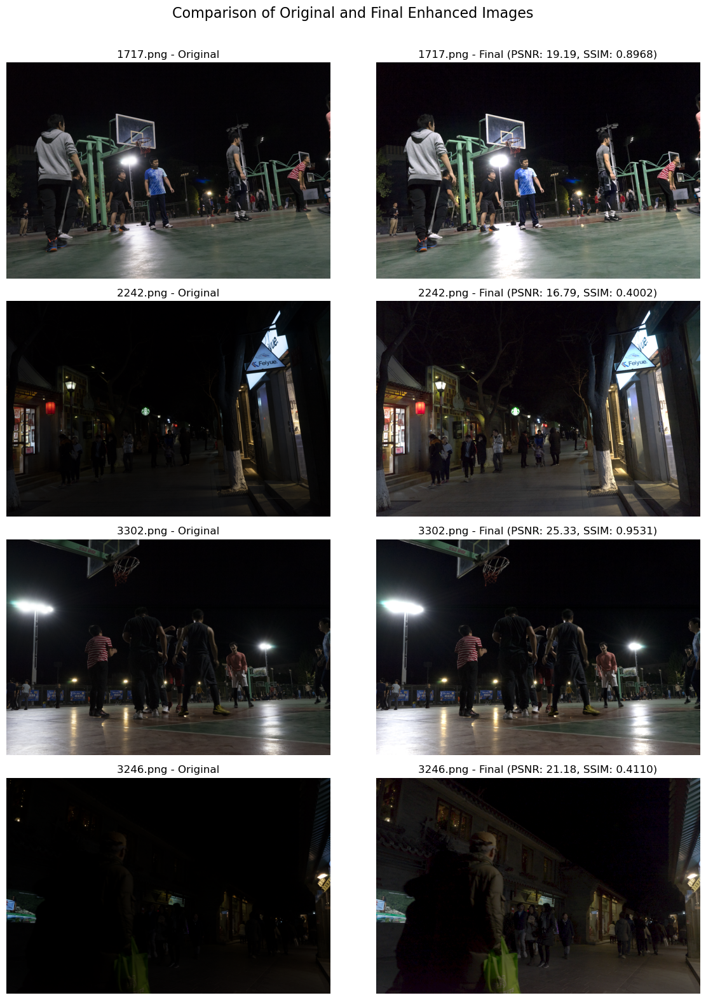

{'1717.png': {'PSNR': 19.18955925441878, 'SSIM': 0.8967608982408195},
 '2242.png': {'PSNR': 16.79266580016637, 'SSIM': 0.40020912325564256},
 '3302.png': {'PSNR': 25.326624453086822, 'SSIM': 0.9530676487584225},
 '3246.png': {'PSNR': 21.181848533977856, 'SSIM': 0.4110295262814201}}

In [66]:
# Reimportar las bibliotecas después del reinicio
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

# Rutas a las imágenes originales y finales
images_info = {
    "1717.png": {"original": "./imagenes_proyecto/1717.png",
                 "final": "./imagenes_transformadas/1717/final_pipeline_stretching/Gamma_1717_stretched.png"},
    "2242.png": {"original": "./imagenes_proyecto/2242.png",
                 "final": "./imagenes_transformadas/2242/final_pipeline_stretching/Gamma_2242_stretched.png"},
    "3302.png": {"original": "./imagenes_proyecto/3302.png",
                 "final": "./imagenes_transformadas/3302/final_pipeline_stretching/Gamma_3302_stretched.png"},
    "3246.png": {"original": "./imagenes_proyecto/3246.png",
                 "final": "./imagenes_transformadas/3246/pipeline_after_clahe/Gamma_0.4_CLAHE_optimized.png"}
}

# Función para calcular PSNR y SSIM
def calculate_metrics(original, transformed):
    psnr_value = psnr(original, transformed, data_range=transformed.max() - transformed.min())
    ssim_value = ssim(original, transformed, channel_axis=-1, data_range=transformed.max() - transformed.min())
    return psnr_value, ssim_value

# Visualizar imágenes y calcular métricas
fig, axes = plt.subplots(len(images_info), 2, figsize=(12, 16))
fig.suptitle("Comparison of Original and Final Enhanced Images", fontsize=16)

metrics_results = {}

for i, (name, paths) in enumerate(images_info.items()):
    # Cargar imágenes
    original_image = imread(paths["original"])
    final_image = imread(paths["final"])
    
    # Calcular métricas
    psnr_value, ssim_value = calculate_metrics(original_image, final_image)
    metrics_results[name] = {"PSNR": psnr_value, "SSIM": ssim_value}
    
    # Mostrar imágenes
    axes[i, 0].imshow(original_image)
    axes[i, 0].axis('off')
    axes[i, 0].set_title(f"{name} - Original")
    
    axes[i, 1].imshow(final_image)
    axes[i, 1].axis('off')
    axes[i, 1].set_title(f"{name} - Final (PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f})")

plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

metrics_results


In [70]:
import os

# Directorio de imágenes finales
final_images_dir = "./imagenes_transformadas/final_images"

# Listar archivos en el directorio
if os.path.exists(final_images_dir):
    final_images_list = os.listdir(final_images_dir)
else:
    final_images_list = []

final_images_list


[]

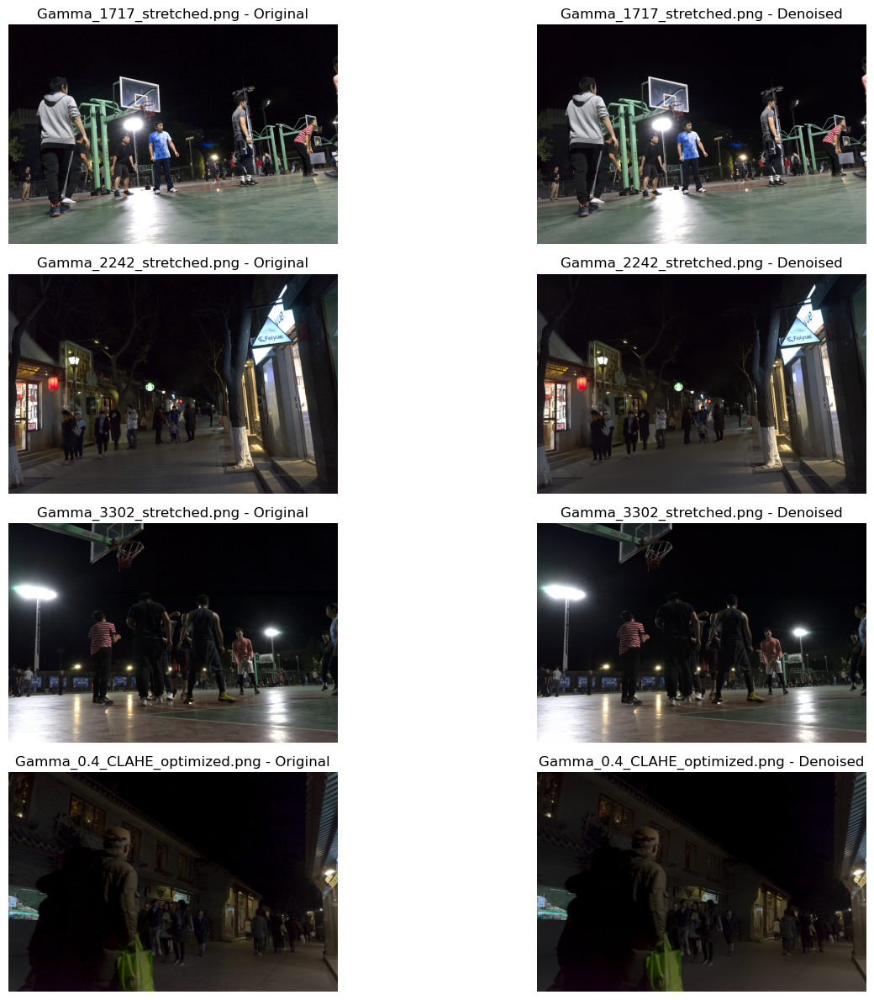

In [73]:
from skimage.restoration import denoise_bilateral
from skimage import img_as_float

# Definir ruta de las imágenes finales
final_images_dir = "./imagenes_transformadas/final_images"
output_dir = "./imagenes_transformadas/final_images_denoised"
os.makedirs(output_dir, exist_ok=True)

# Nombres de las imágenes
image_names = ["Gamma_1717_stretched.png",
               "Gamma_2242_stretched.png",
               "Gamma_3302_stretched.png",
               "Gamma_0.4_CLAHE_optimized.png"]

# Aplicar filtro de reducción de ruido bilateral
denoised_images = {}

for img_name in image_names:
    # Leer imagen
    img_path = os.path.join(final_images_dir, img_name)
    img = imread(img_path)
    img_float = img_as_float(img)  # Convertir a float [0, 1]
    
    # Aplicar filtro bilateral
    denoised_img = denoise_bilateral(img_float, sigma_color=0.01, sigma_spatial=12, channel_axis=-1)
    denoised_images[img_name] = denoised_img
    
    # Guardar imagen denoised
    output_path = os.path.join(output_dir, img_name)
    plt.imsave(output_path, denoised_img)

# Visualizar resultados
fig, axes = plt.subplots(len(image_names), 2, figsize=(15, 12))
for i, img_name in enumerate(image_names):
    original_img = imread(os.path.join(final_images_dir, img_name))
    denoised_img = denoised_images[img_name]
    
    # Imagen original
    axes[i, 0].imshow(original_img)
    axes[i, 0].set_title(f"{img_name} - Original")
    axes[i, 0].axis('off')
    
    # Imagen denoised
    axes[i, 1].imshow(denoised_img)
    axes[i, 1].set_title(f"{img_name} - Denoised")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()


<h1>Estos resultados son bastante malos asique no los vamos a tener en cuenta.</h1>